In [2]:
import numpy as np
import pandas as pd
df = pd.read_pickle('male_test.pkl')
import nibabel as nib
import matplotlib.pyplot as plt
import seaborn as sns
# sns.set()

In [3]:
df.iloc[0].dataframe

,Unnamed: 0,target_age,output_age_1,age_delta_1,loss_1,output_age_2,age_delta_2,loss_2,output_age_3,age_delta_3,loss_3,mean_output_age,mean_age_delta,output_age_decon,age_delta_decon
0,25604371,67.942123,67.507900,-0.434227,0.188553,69.783430,1.841309,3.390418,67.384964,-0.557159,0.310426,68.225431,0.283308,69.078959,1.136836
1,23448390,56.832306,62.910760,6.078453,36.947591,64.360460,7.528152,56.673079,64.519295,7.686989,59.089797,63.930172,7.097866,63.853619,7.021313
2,24979938,52.831164,50.722595,-2.108569,4.446064,52.619720,-0.211444,0.044709,53.288006,0.456841,0.208704,52.210107,-0.621057,49.595733,-3.235432
3,25491324,67.269977,65.640020,-1.629955,2.656753,66.204270,-1.065708,1.135733,66.447070,-0.822910,0.677181,66.097120,-1.172857,66.489791,-0.780186
4,21451642,56.467009,50.530365,-5.936644,35.243744,51.535126,-4.931883,24.323474,50.964710,-5.502299,30.275293,51.010067,-5.456942,48.135840,-8.331169
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4360,25869023,54.817237,53.636505,-1.180732,1.394129,53.514510,-1.302726,1.697096,56.241024,1.423787,2.027168,54.464013,-0.353224,52.337692,-2.479546
4361,25681811,62.667237,64.949100,2.281859,5.206882,65.553510,2.886275,8.330584,65.397430,2.730193,7.453954,65.300013,2.632776,65.520081,2.852844
4362,23068218,75.562900,75.194565,-0.368335,0.135670,76.616380,1.053479,1.109819,72.613785,-2.949115,8.697278,74.808243,-0.754656,77.087190,1.524290
4363,21199766,77.999658,69.663270,-8.336388,69.495373,70.705340,-7.294320,53.207104,71.817310,-6.182351,38.221464,70.728640,-7.271018,72.124204,-5.875454


# Identify Subjects Predicted 45-50 and 75-80 

FOR THE TRAIN DATABASE

Male min, max, average: 45.12545662100456 82.26312785388131 63.370316719492536

Female min, max, average: 45.451940639269424 82.17979452054806 64.64810970818492

In [4]:
young_low = 45
young_high = 52
old_low = 75
old_high = 82

# young_low = 45
# young_high = 50
# old_low = 77
# old_high = 82

dct = {}
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    df_name = df.iloc[idx].modality
    df_dct = {}
    young_subjects = df_mod[(df_mod.mean_output_age >= young_low) & (df_mod.mean_output_age <= young_high)]['Unnamed: 0'].to_numpy()
    old_subjects =  df_mod[(df_mod.mean_output_age >= old_low) & (df_mod.mean_output_age <= old_high)]['Unnamed: 0'].to_numpy()
    df_dct['young'] = young_subjects
    df_dct['old'] = old_subjects
    dct[df_name] = df_dct

dct = pd.DataFrame.from_dict(dct)

In [5]:
dct

,T1_nonlinear,T1_linear,jacobian,vbm,T2_nonlinear,T2_lesions,swi,rsfmri_0,rsfmri_1,rsfmri_2,...,tbss_OD_s,tbss_FA,tbss_ICVF,tbss_ISOVF,tbss_L1,tbss_L2,tbss_L3,tbss_MD,tbss_MO,tbss_OD
young,"[21451642, 24591917, 24775864, 21767199, 23459...","[24979938, 24591917, 24258852, 22258684, 21767...","[24591917, 21266822, 21613326, 22844334, 24014...","[24979938, 21451642, 24591917, 22984475, 23337...","[24591917, 24775864, 21214849, 21886220, 22193...","[21451642, 23944708, 21864242, 21613326, 21006...","[21451642, 21266822, 22258684, 21767199, 24495...","[24014646, 25635481, 24185089, 24990862, 21151...","[22957710, 25684391, 22617637, 22489887, 23377...","[22541922, 23885100, 21894433, 21185366]",...,"[21767199, 21886220, 21594713, 21613326, 24014...","[24591917, 23337252, 21767199, 25131915, 21613...","[24979938, 21451642, 26005419, 22258684, 21214...","[24591917, 26005419, 21266822, 23337252, 21214...","[24591917, 21134996, 26005419, 22984475, 21214...","[21266822, 21788286, 21006213, 24014646, 25635...","[24591917, 26005419, 22984475, 21214849, 24542...","[24591917, 22984475, 21214849, 21788286, 21006...","[21266822, 21767199, 22474318, 22844334, 24014...","[24979938, 24591917, 24258852, 26005419, 22984..."
old,"[23992861, 24868402, 23008270, 22261585, 24750...","[23992861, 24868402, 24242107, 24750546, 23287...","[24780906, 21151236, 22261585, 24750546, 23287...","[23992861, 23008270, 24242107, 24750546, 23287...","[23992861, 23008270, 24242107, 24750546, 23287...","[24750546, 23287872, 24536466, 23398626, 21044...","[21254786, 23287872, 22947623, 23398626, 21044...","[22252847, 24461189, 23331610, 21509068, 23885...","[24750546, 24180535, 23686832, 23639414, 23426...","[23287872, 22638094, 22252847, 23523462, 22663...",...,"[22261585, 22537700, 24242107, 24750546, 23287...","[23635637, 22261585, 24242107, 24750546, 24536...","[22537700, 24242107, 24750546, 24180535, 23398...","[24242107, 24750546, 21044708, 24156284, 25751...","[21254786, 24242107, 24750546, 24156284, 24169...","[23992861, 23635637, 22261585, 24242107, 24750...","[23992861, 22261585, 24242107, 24750546, 23287...","[23992861, 24242107, 24750546, 24180535, 22083...","[23992861, 24242107, 25678071, 23287872, 24536...","[25678071, 23287872, 24536466, 21044708, 24156..."


In [6]:
print("{:13}  : {:8}  |  {:15}".format('Modality', 'Young', "Old"))
print('-----------------------------------------------------------------------------------------------')

for column in dct.columns:
    no_young = len(dct[column].young)
    no_old = len(dct[column].old)
    print('"{:13} :  {:6}   |   {}'.format(column, no_young, no_old))


Modality       : Young     |  Old            
-----------------------------------------------------------------------------------------------
"T1_nonlinear  :     113   |   196
"T1_linear     :     117   |   244
"jacobian      :      70   |   192
"vbm           :     126   |   227
"T2_nonlinear  :     108   |   203
"T2_lesions    :      29   |   88
"swi           :      66   |   191
"rsfmri_0      :      15   |   28
"rsfmri_1      :       8   |   57
"rsfmri_2      :       4   |   13
"rsfmri_3      :       6   |   38
"rsfmri_4      :      14   |   82
"rsfmri_5      :      22   |   97
"rsfmri_6      :       3   |   5
"rsfmri_7      :       1   |   6
"rsfmri_8      :       2   |   26
"rsfmri_9      :      11   |   81
"rsfmri_10     :       5   |   25
"rsfmri_11     :       3   |   33
"rsfmri_12     :       2   |   34
"rsfmri_13     :       5   |   56
"rsfmri_14     :       4   |   8
"rsfmri_15     :       0   |   5
"rsfmri_16     :      19   |   50
"rsfmri_17     :      10   |   43
"rsfmr

In [6]:
dct.to_pickle('male_young_old_subjects_prototype.pkl', protocol = 4)

In [7]:
dct2 = pd.read_pickle('male_young_old_subjects_prototype.pkl')

In [8]:
dct2

,T1_nonlinear,T1_linear,jacobian,vbm,T2_nonlinear,T2_lesions,swi,rsfmri_0,rsfmri_1,rsfmri_2,...,tbss_OD_s,tbss_FA,tbss_ICVF,tbss_ISOVF,tbss_L1,tbss_L2,tbss_L3,tbss_MD,tbss_MO,tbss_OD
young,"[25206481, 25479772, 24715788, 25081518, 22744...","[25479772, 23070767, 24715788, 25081518, 22744...","[25206481, 24267361, 24847339, 23601409, 21582...","[25479772, 25416399, 24715788, 21509869, 22471...","[25479772, 24715788, 23461330, 22324415, 22744...","[21582590, 24385774, 23134256, 25969246, 23800...","[23936004, 25479772, 23070767, 23105121, 25416...","[22911200, 25120910, 24390285, 23334012, 23800...","[21586289, 23461330, 21334379, 25752154, 25120...","[22324415, 22911200, 21582590, 21364188, 22163...",...,"[23936004, 25479772, 23070767, 23461330, 25081...","[25479772, 25416399, 23461330, 22324415, 21509...","[25479772, 23461330, 22324415, 22744799, 24847...","[25479772, 23070767, 24715788, 23461330, 22324...","[23936004, 25479772, 23461330, 22324415, 25081...","[23936004, 25479772, 23070767, 23461330, 22324...","[25206481, 23936004, 25479772, 23070767, 23461...","[23936004, 25479772, 23070767, 23461330, 22324...","[25206481, 23936004, 25479772, 22324415, 25081...","[23936004, 25479772, 23105121, 24715788, 22744..."
old,"[24237795, 23425786, 25668308, 23416460, 21794...","[24237795, 25417099, 23425786, 23416460, 21794...","[23425786, 21794168, 22227657, 22769658, 24861...","[24237795, 23913216, 23425786, 25668308, 21794...","[23425786, 25668308, 21794168, 24472502, 22235...","[24237795, 22205519, 22171526, 22235683, 21085...","[24237795, 21794168, 22227657, 22769658, 22726...","[22387192, 22235683, 21624632, 24335314, 21427...","[21898466, 24358015, 22235683, 24335314, 21427...","[22233988, 22235683, 24335314, 21427767, 25705...",...,"[24237795, 23913216, 23416460, 21794168, 22227...","[24237795, 23425786, 23416460, 22227657, 21007...","[23913216, 23425786, 23416460, 24358015, 24360...","[23913216, 23425786, 25668308, 22227657, 22769...","[23425786, 23416460, 22227657, 24358015, 21632...","[24237795, 25417099, 23425786, 25668308, 23416...","[23425786, 25668308, 23416460, 22227657, 24358...","[24237795, 23913216, 23425786, 22227657, 21007...","[24237795, 23425786, 21794168, 21007431, 22185...","[24237795, 23425786, 25668308, 23416460, 21794..."


# Code to Average Across All Subjects (DO NOT RUN LOCALLY)

```bash
scp Analysis/male_young_old_subjects_prototype.pkl hsv459@cluster1.bmrc.ox.ac.uk:/well/win/users/hsv459/agemapper/Analysis
```
and after...
```bash
scp -r hsv459@cluster1.bmrc.ox.ac.uk:/well/win/users/hsv459/agemapper/Analysis Analysis_data/
```

In [9]:
# #!/bin/bash

# cd /well/win/users/hsv459/agemapper

# module purge
# module load Python/3.7.4-GCCcore-8.3.0

# # determine Ivybridge or Skylake compatibility on this node
# CPU_ARCHITECTURE=$(/apps/misc/utils/bin/get-cpu-software-architecture.py)

# # Error handling
# if [[ ! $? == 0 ]]; then
#   echo "Fatal error: Please send the following information to the BMRC team: Could not determine CPU software architecture on $(hostname)"
#   exit 1
# fi

# # Activate the ivybridge or skylake version of your python virtual environment
# source /well/win/users/hsv459/python/functionmapper-${CPU_ARCHITECTURE}/bin/activate

  
# ipython

```bash
#!/bin/bash

cd /well/win/users/hsv459/agemapper

module purge
module load Python/3.7.4-GCCcore-8.3.0

# determine Ivybridge or Skylake compatibility on this node
CPU_ARCHITECTURE=$(/apps/misc/utils/bin/get-cpu-software-architecture.py)

# Error handling
if [[ ! $? == 0 ]]; then
  echo "Fatal error: Please send the following information to the BMRC team: Could not determine CPU software architecture on $(hostname)"
  exit 1
fi

# Activate the ivybridge or skylake version of your python virtual environment
source /well/win/users/hsv459/python/functionmapper-${CPU_ARCHITECTURE}/bin/activate

  
ipython
```

In [10]:
# import numpy as np
# import pandas as pd
# from fsl.data.image import Image
# import nibabel as nib
# import os

# data_directory = "/well/win-biobank/projects/imaging/data/data3/subjectsAll/"

# young_old_subjects_path = 'Analysis/male_young_old_subjects_prototype.pkl'
# df = pd.read_pickle(young_old_subjects_path)
# modalities = df.columns.to_list()

# scaling_values_path = "datasets/scaling_values_simple.csv"
# scaling_values_simple = pd.read_csv(scaling_values_path, index_col=0)

# if not os.path.exists('Analysis/average_maps'):
#     os.mkdir('Analysis/average_maps')
    
# if not os.path.exists('Analysis/average_maps/male'):
#     os.mkdir('Analysis/average_maps/male')

# def compute_mean(file_paths):

#     mean_volume = None
#     volume_number = len(file_paths)
    
#     index = 0
    
#     for file_path in file_paths:

#         if rsfmri_volume != None:
#             volume = np.array(nib.load(file_path).dataobj)[:,:,:,rsfmri_volume]
#         else:
#             volume = np.array(nib.load(file_path).dataobj)
            
#         if index == 0:
#             mean_volume = np.copy(volume)
#             header = Image(file_path).header
#         else:
#             mean_volume += volume
            
#         index += 1
            
#     mean_volume = np.divide(mean_volume, volume_number)
    
#     return mean_volume, header


# index = 1

# for modality in modalities:
    
#     modality_split = modality.rsplit('_', 1)
#     if modality_split[0] == 'rsfmri':
#         rsfmri_volume = int(modality_split[1])
#     else:
#         rsfmri_volume = None
        
    
#     data_file = scaling_values_simple.loc[modality].data_file
#     young_subjects = df[modality].young
#     old_subjects = df[modality].old
    
#     young_file_paths = [os.path.join(data_directory, str(volume), data_file) for volume in young_subjects]
#     old_file_paths = [os.path.join(data_directory, str(volume), data_file) for volume in old_subjects]
    
#     young_mean_volume, young_header = compute_mean(young_file_paths)
#     old_mean_volume, old_header = compute_mean(old_file_paths)
#     difference_volume = np.subtract(young_mean_volume, old_mean_volume)
    
#     young_volume_image = Image(young_mean_volume, header=young_header)
#     old_volume_image = Image(old_mean_volume, header=old_header)
#     difference_volume_image = Image(difference_volume, header=young_header)
    
#     young_save_path = 'Analysis/average_maps/male/' + modality + '_young_mean_volume.nii.gz'
#     old_save_path = 'Analysis/average_maps/male/' + modality + '_old_mean_volume.nii.gz'
#     difference_save_path = 'Analysis/average_maps/male/' + modality + '_difference_volume.nii.gz'
    
#     young_volume_image.save(young_save_path)
#     old_volume_image.save(old_save_path)
#     difference_volume_image.save(difference_save_path)

#     print("\r Processed {:.3f}%: {}/{} modalities".format(index/len(modalities) * 100.0, index, len(modalities)), end='')
#     index += 1


```python

import numpy as np
import pandas as pd
from fsl.data.image import Image
import nibabel as nib
import os

data_directory = "/well/win-biobank/projects/imaging/data/data3/subjectsAll/"

young_old_subjects_path = 'Analysis/male_young_old_subjects_prototype.pkl'
df = pd.read_pickle(young_old_subjects_path)
modalities = df.columns.to_list()

scaling_values_path = "datasets/scaling_values_simple.csv"
scaling_values_simple = pd.read_csv(scaling_values_path, index_col=0)

if not os.path.exists('Analysis/average_maps'):
    os.mkdir('Analysis/average_maps')
    
if not os.path.exists('Analysis/average_maps/male'):
    os.mkdir('Analysis/average_maps/male')

def compute_mean(file_paths):

    mean_volume = None
    volume_number = len(file_paths)
    
    index = 0
    
    for file_path in file_paths:

        if rsfmri_volume != None:
            volume = np.array(nib.load(file_path).dataobj)[:,:,:,rsfmri_volume]
        else:
            volume = np.array(nib.load(file_path).dataobj)
            
        if index == 0:
            mean_volume = np.copy(volume)
            header = Image(file_path).header
        else:
            mean_volume += volume
            
        index += 1
            
    mean_volume = np.divide(mean_volume, volume_number)
    
    return mean_volume, header


index = 1

for modality in modalities:
    
    modality_split = modality.rsplit('_', 1)
    if modality_split[0] == 'rsfmri':
        rsfmri_volume = int(modality_split[1])
    else:
        rsfmri_volume = None
        
    
    data_file = scaling_values_simple.loc[modality].data_file
    young_subjects = df[modality].young
    old_subjects = df[modality].old
    
    young_file_paths = [os.path.join(data_directory, str(volume), data_file) for volume in young_subjects]
    old_file_paths = [os.path.join(data_directory, str(volume), data_file) for volume in old_subjects]
    
    young_mean_volume, young_header = compute_mean(young_file_paths)
    old_mean_volume, old_header = compute_mean(old_file_paths)
    difference_volume = np.subtract(young_mean_volume, old_mean_volume)
    
    young_volume_image = Image(young_mean_volume, header=young_header)
    old_volume_image = Image(old_mean_volume, header=old_header)
    difference_volume_image = Image(difference_volume, header=young_header)
    
    young_save_path = 'Analysis/average_maps/male/' + modality + '_young_mean_volume.nii.gz'
    old_save_path = 'Analysis/average_maps/male/' + modality + '_old_mean_volume.nii.gz'
    difference_save_path = 'Analysis/average_maps/male/' + modality + '_difference_volume.nii.gz'
    
    young_volume_image.save(young_save_path)
    old_volume_image.save(old_save_path)
    difference_volume_image.save(difference_save_path)

    print("\r Processed {:.3f}%: {}/{} modalities".format(index/len(modalities) * 100.0, index, len(modalities)), end='')
    index += 1



```

# Plotting The Difference Maps

In [10]:
pth_base = "../Analysis_data/Analysis/average_maps/male"

In [11]:
modalities = df.modality.to_list()

In [12]:
def visualise_difference_maps(img, modality):

    fig, axes = plt.subplots(1, 5, figsize=(30,6), facecolor='white')

    middle = int(img.shape[2]/2) - 1
    
    if middle == 44:
        locations = [middle-4, middle-2, middle, middle+2, middle+4]
    else:
        locations = [middle-8, middle-4, middle, middle+4, middle+8]
        
    if modality == 'tracts':
        locations = [middle-20, middle-15, middle-10, middle-5, middle]

    for i, ax in enumerate(axes.flat):
        im = ax.imshow(np.rot90(img[:,:,locations[i]],1), cmap='bwr', 
                       vmin=-min(np.abs(np.min(img)), np.abs(np.max(img))), 
                       vmax=min(np.abs(np.min(img)), np.abs(np.max(img))))
        ax.grid(False)
        ax.axis('off')

    # fig.subplots_adjust(right=0.8)
    # cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
    # fig.colorbar(im, cax=cbar_ax)

    cbar = fig.colorbar(im, ax=axes.ravel().tolist())
    cbar.ax.tick_params(labelsize=15)

    plt.suptitle(modality, fontsize='xx-large')

    plt.show()
    
    
# Take ventricle volume and regressing age from ventricle volume
# f(x)=y --- y = age, x = csf volume (not strictly the same)
# fast outputs -- sum 3rd channel
# if done with NL, normalize for head size as well

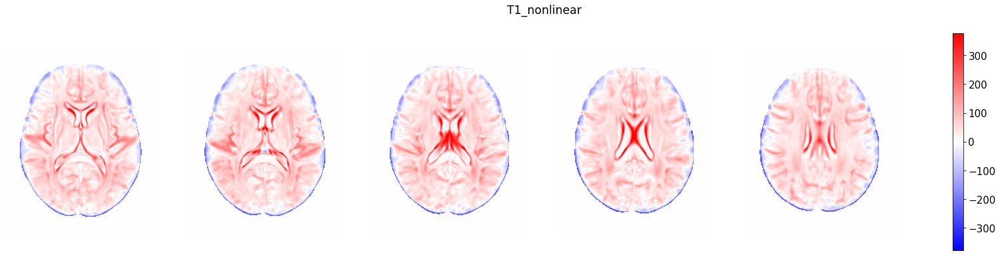

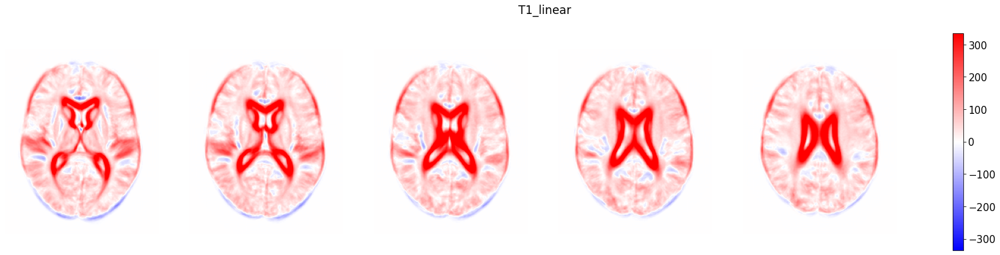

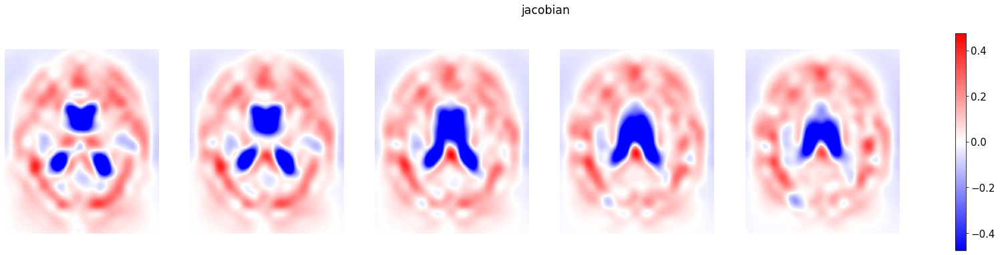

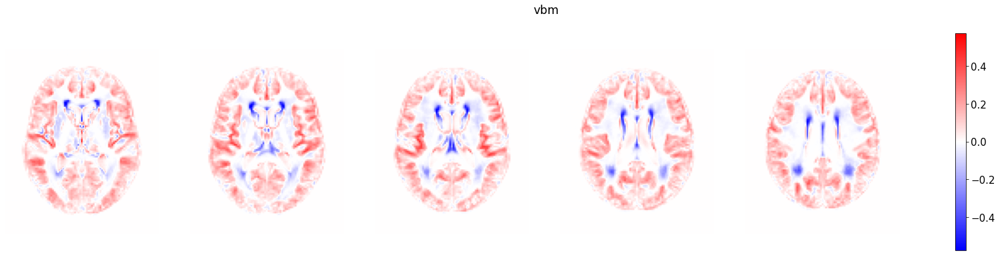

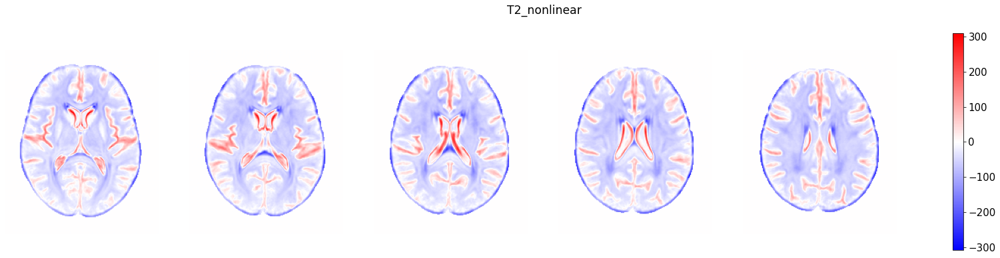

...

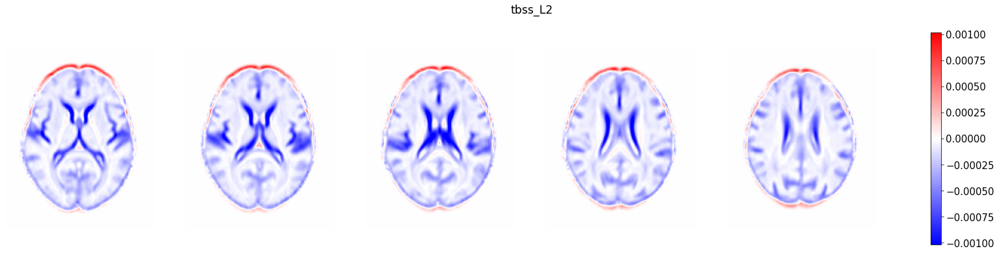

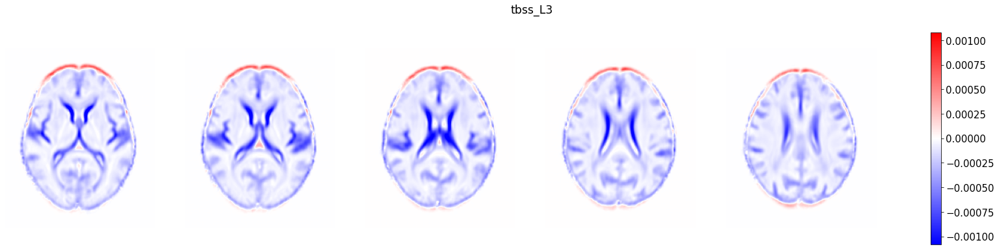

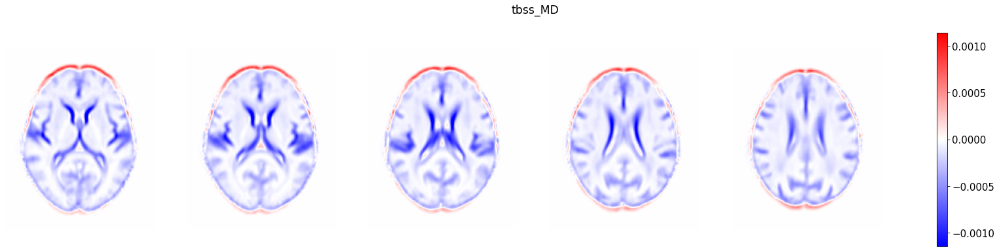

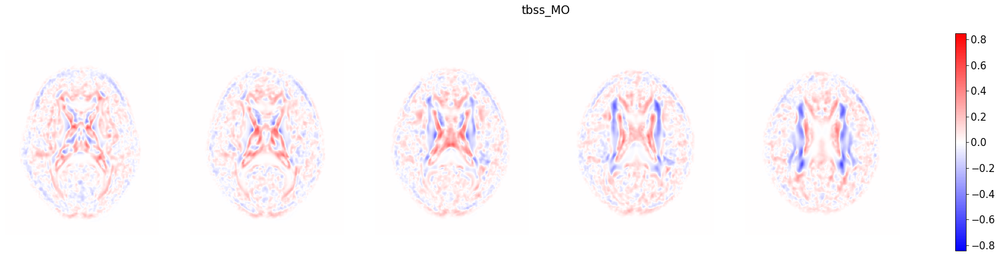

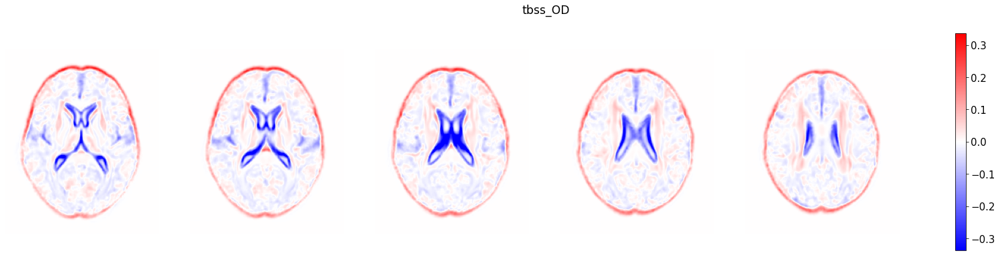

In [14]:
for modality in modalities:
    file_path = pth_base + '/' + modality + "_difference_volume.nii.gz"
    img = nib.load(file_path).get_fdata()
    visualise_difference_maps(img, modality)

In [40]:
def visualise_all_maps(modality):

    
    file_path_young = pth_base + '/' + modality + "_young_mean_volume.nii.gz"
    img_young = nib.load(file_path_young).get_fdata()
    
    file_path_old = pth_base + '/' + modality + "_old_mean_volume.nii.gz"
    img_old = nib.load(file_path_old).get_fdata()
    
    file_path_difference = pth_base + '/' + modality + "_difference_volume.nii.gz"
    img_difference = nib.load(file_path_difference).get_fdata()
    
    
    fig, axes = plt.subplots(3, 5, figsize=(30,17), facecolor='white')

    middle = int(img_difference.shape[2]/2) - 1
    
    if middle == 44:
        locations = [middle-4, middle-2, middle, middle+2, middle+4]
        text_location = 55
    else:
        locations = [middle-8, middle-4, middle, middle+4, middle+8]
        text_location = 109
        
    if modality == 'tracts':
        locations = [middle-20, middle-15, middle-10, middle-5, middle]

    modality_flag_split = modality.rsplit('_', 1)
    
    ylabels = ['Young Subjects', 'Old Subjects', 'Young - Old\nDifference']
        
        
    for i, ax in enumerate(axes.flat):
        
        if i < 5:
            img = img_young
            if modality_flag_split[0] in ['rsfmri', 'tfmri']:
                im = ax.imshow(np.rot90(img[:,:,locations[i]],1), cmap='gray', 
                               vmin=-min(np.abs(np.min(img)), np.abs(np.max(img))), 
                               vmax=min(np.abs(np.min(img)), np.abs(np.max(img)))) 
            elif modality_flag_split[0] in ['tracts']:
                im = ax.imshow(np.rot90(img[:,:,locations[i]],1), cmap='gray', 
                               vmin=-min(np.abs(np.min(img)), np.abs(np.max(img))), 
                               vmax=max(np.abs(np.min(img)), np.abs(np.max(img)))*0.33)
            else:
                im = ax.imshow(np.rot90(img[:,:,locations[i]],1), cmap='gray') 
            ax.grid(False)
            ax.axis('off')
        elif i < 10:
            img = img_old
            if modality_flag_split[0] in ['rsfmri', 'tfmri']:
                im = ax.imshow(np.rot90(img[:,:,locations[i-5]],1), cmap='gray', 
                               vmin=-min(np.abs(np.min(img)), np.abs(np.max(img))), 
                               vmax=min(np.abs(np.min(img)), np.abs(np.max(img)))) 
            elif modality_flag_split[0] in ['tracts']:
                im = ax.imshow(np.rot90(img[:,:,locations[i-5]],1), cmap='gray', 
                               vmin=-min(np.abs(np.min(img)), np.abs(np.max(img))), 
                               vmax=max(np.abs(np.min(img)), np.abs(np.max(img)))*0.33)
            else:
                im = ax.imshow(np.rot90(img[:,:,locations[i-5]],1), cmap='gray') 
            ax.grid(False)
            ax.axis('off')
        else:
            img = img_difference
            im = ax.imshow(np.rot90(img[:,:,locations[i-10]],1), cmap='bwr', 
                       vmin=-min(np.abs(np.min(img)), np.abs(np.max(img))), 
                       vmax=min(np.abs(np.min(img)), np.abs(np.max(img))))
            ax.grid(False)
            ax.axis('off')
    
    fts_size = 40
    
    for ax, label in zip(axes[:,0], ylabels):
        ax.annotate(label, xy=(0,text_location), fontsize=fts_size, rotation='vertical', 
                    ha='right', 
                    va='center',
                   )

    cbar = fig.colorbar(im, ax=axes.ravel().tolist())
    cbar.ax.tick_params(labelsize=fts_size)

    plt.suptitle(modality, fontsize=fts_size)
    
#     plt.tight_layout()
    plt.show()

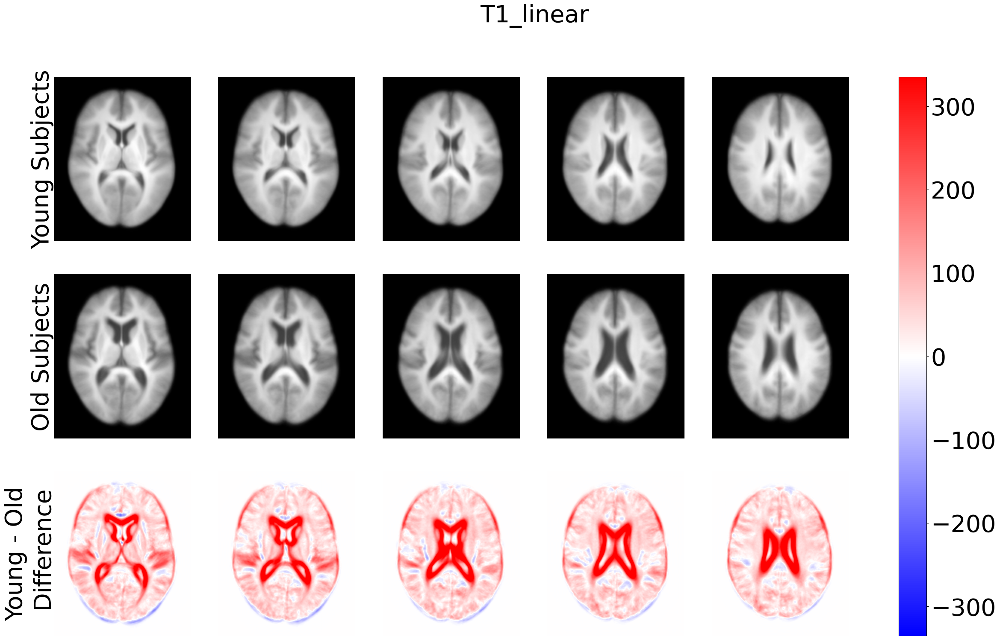

In [41]:
visualise_all_maps(modalities[1])

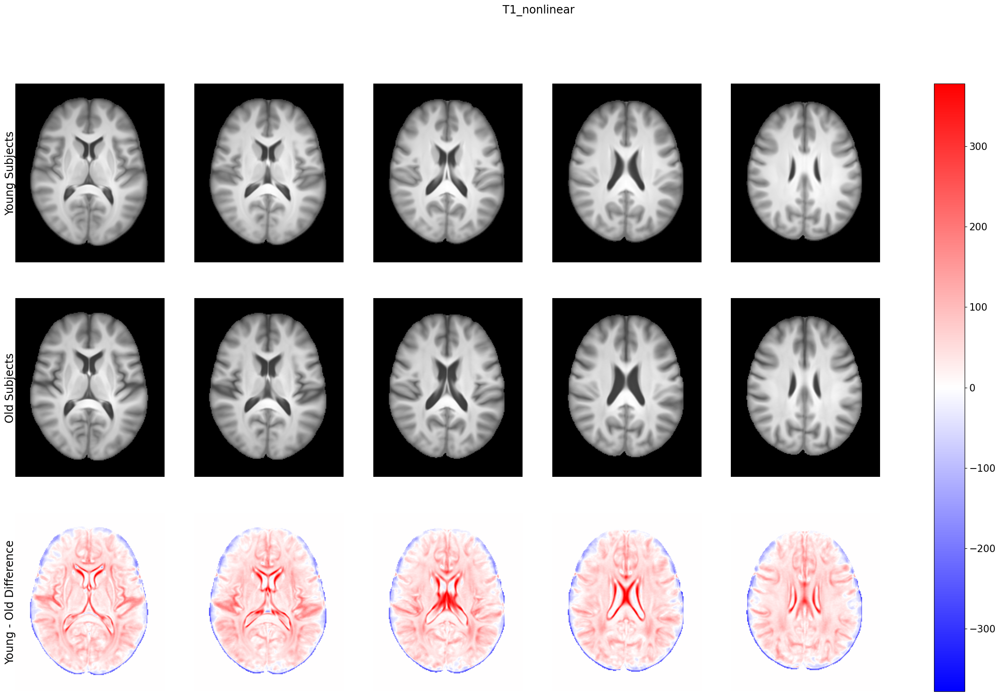

--------------------------------------------------------


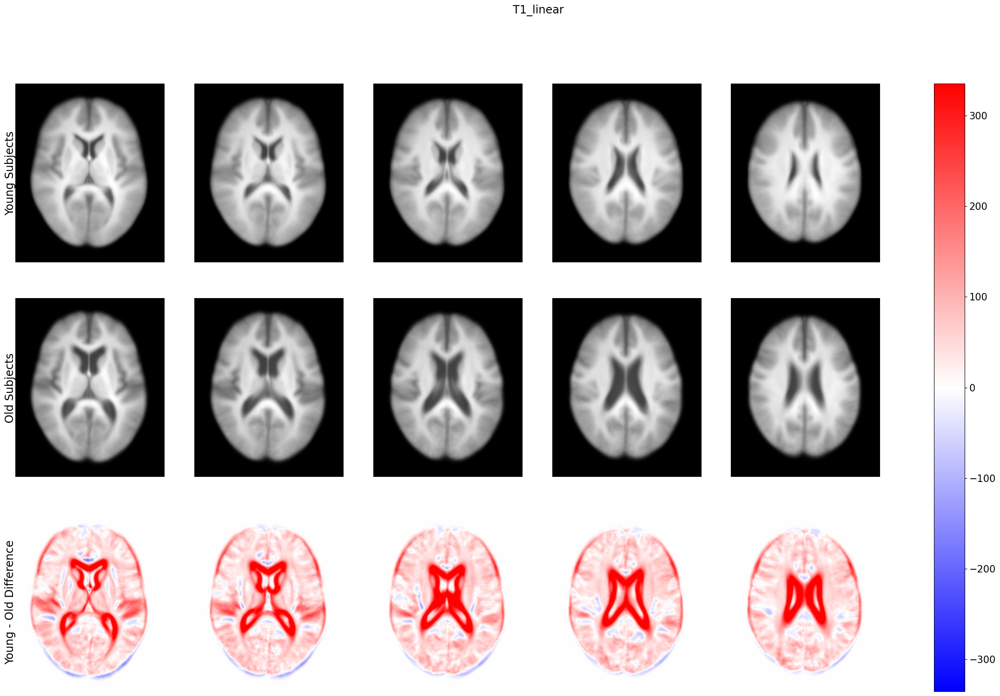

--------------------------------------------------------


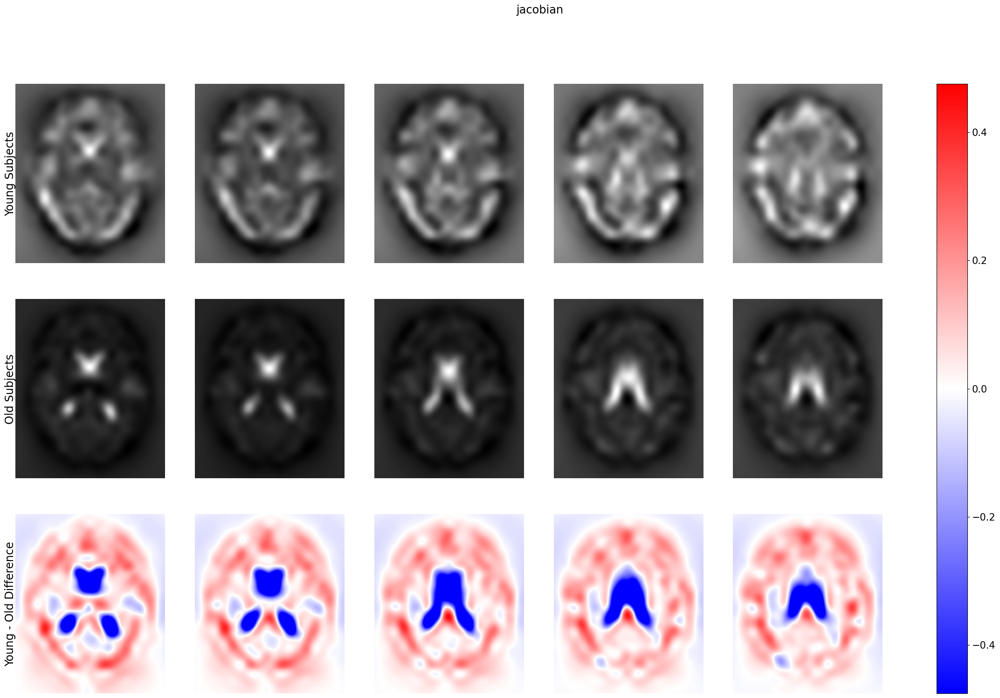

--------------------------------------------------------


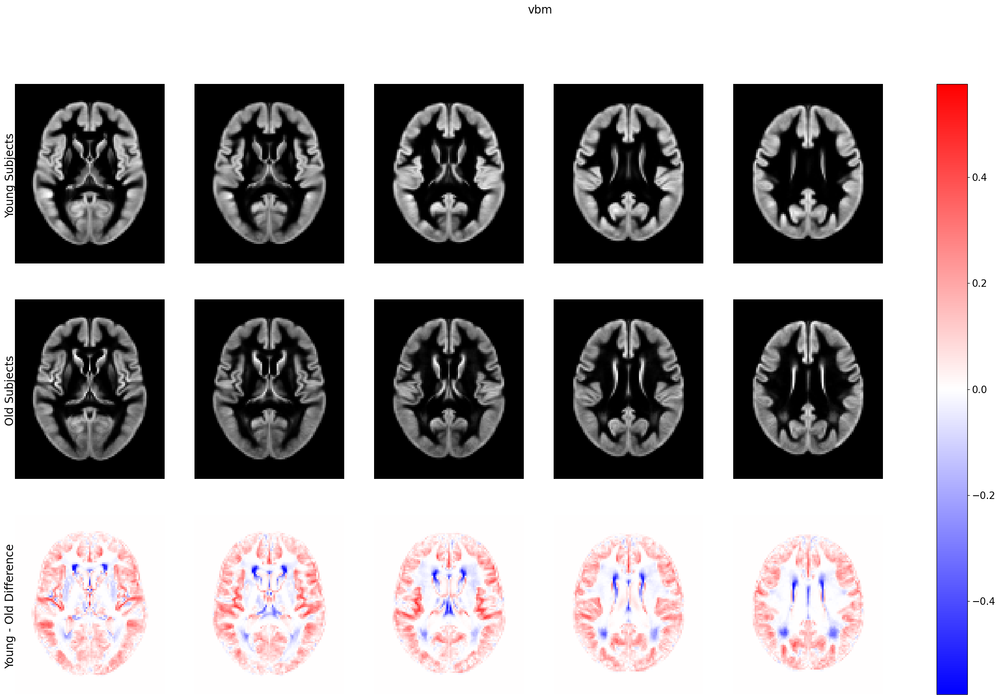

--------------------------------------------------------


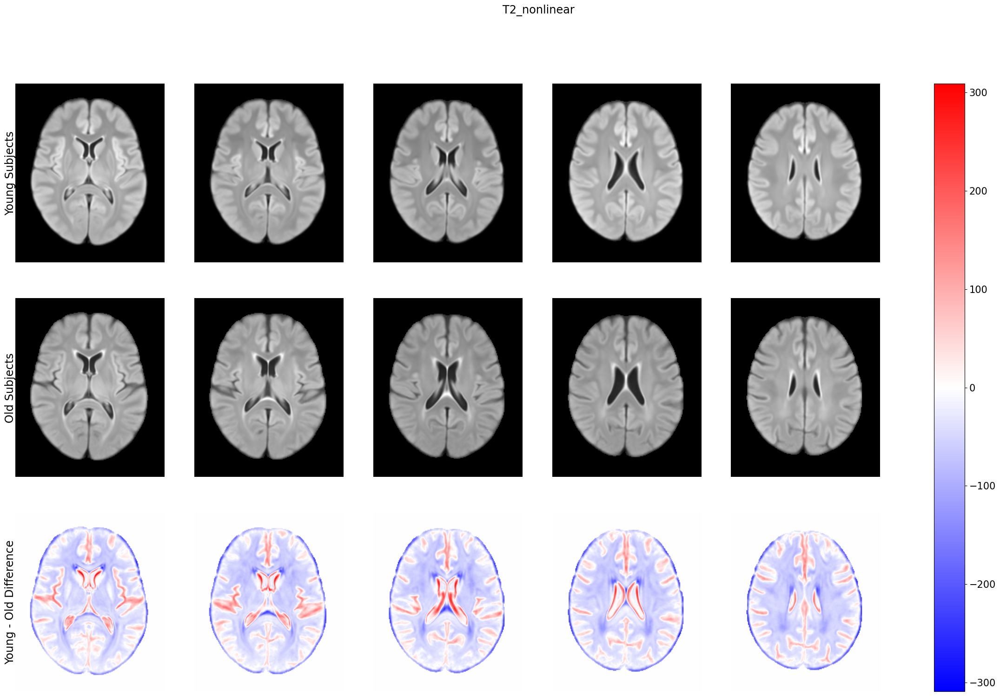

--------------------------------------------------------


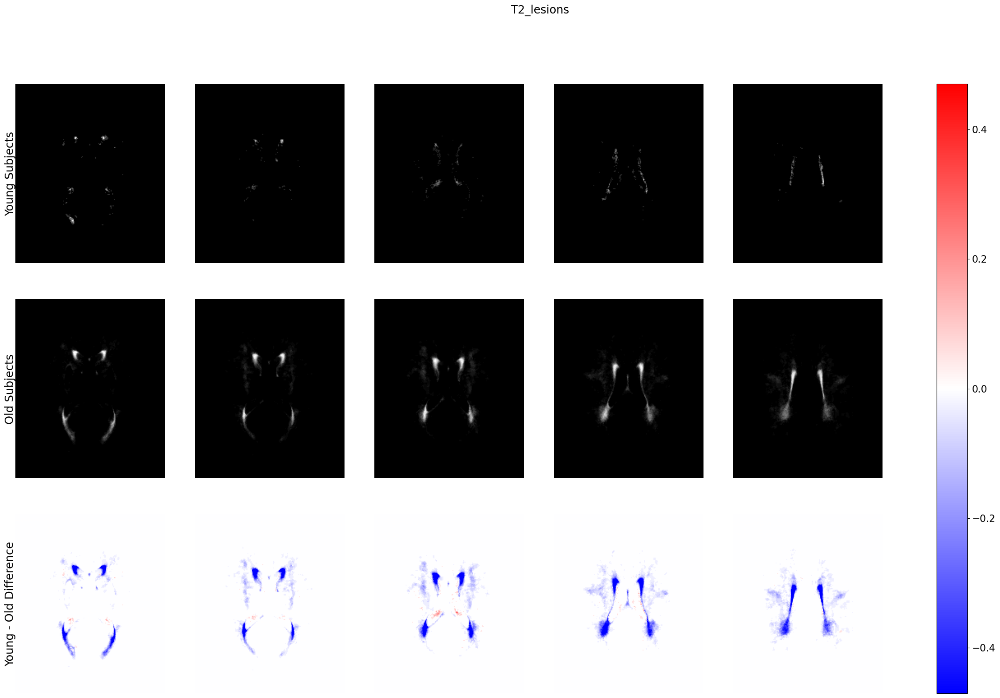

--------------------------------------------------------


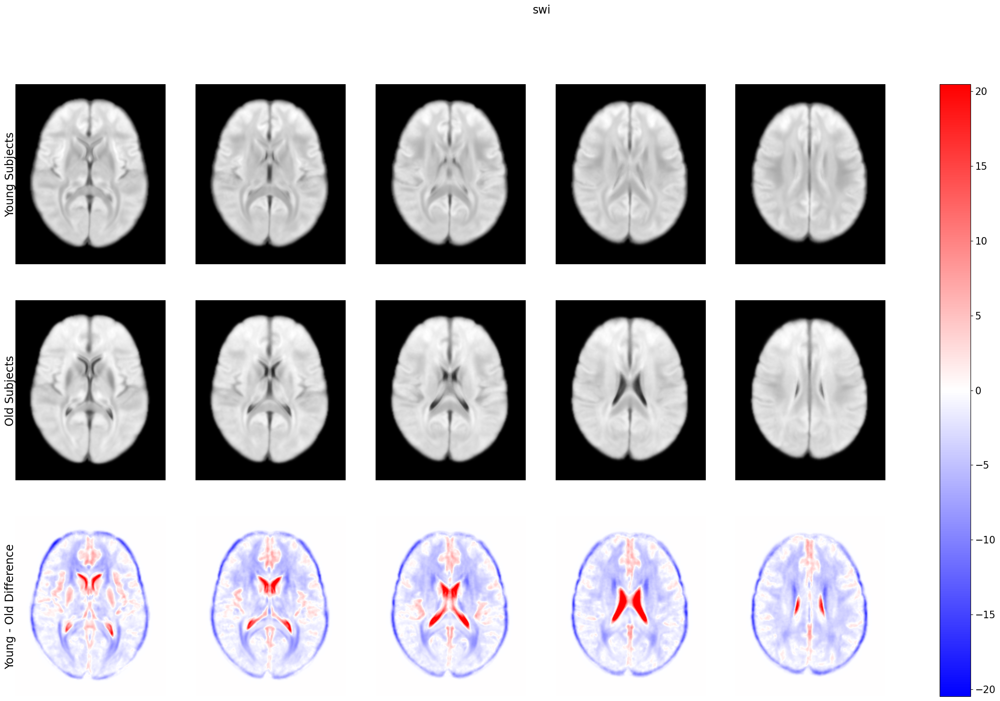

--------------------------------------------------------


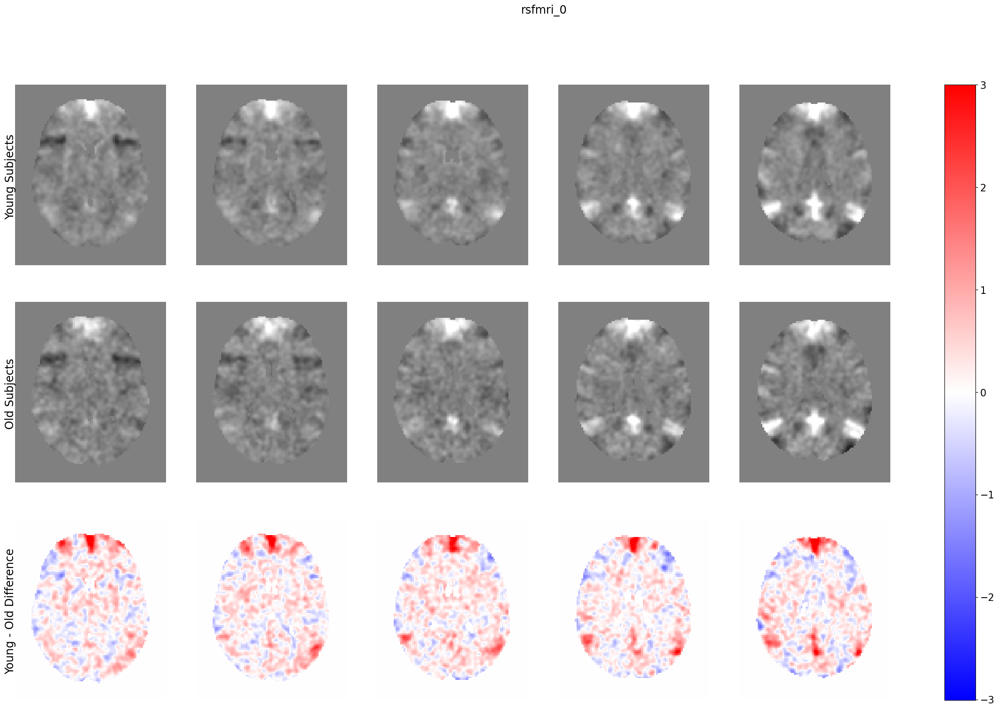

--------------------------------------------------------


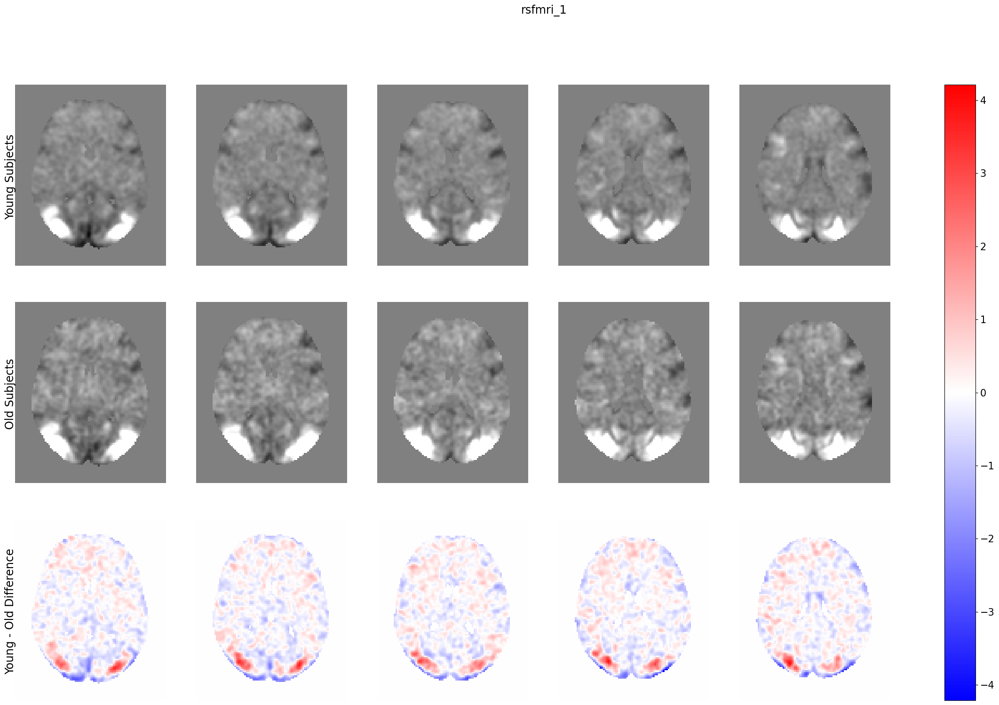

--------------------------------------------------------


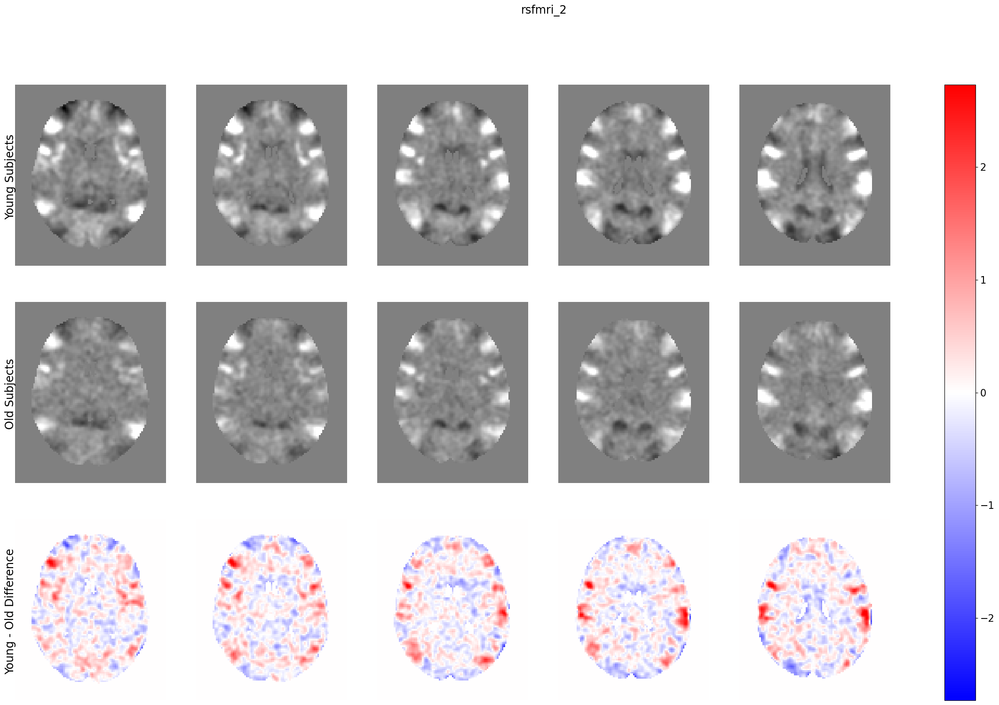

--------------------------------------------------------


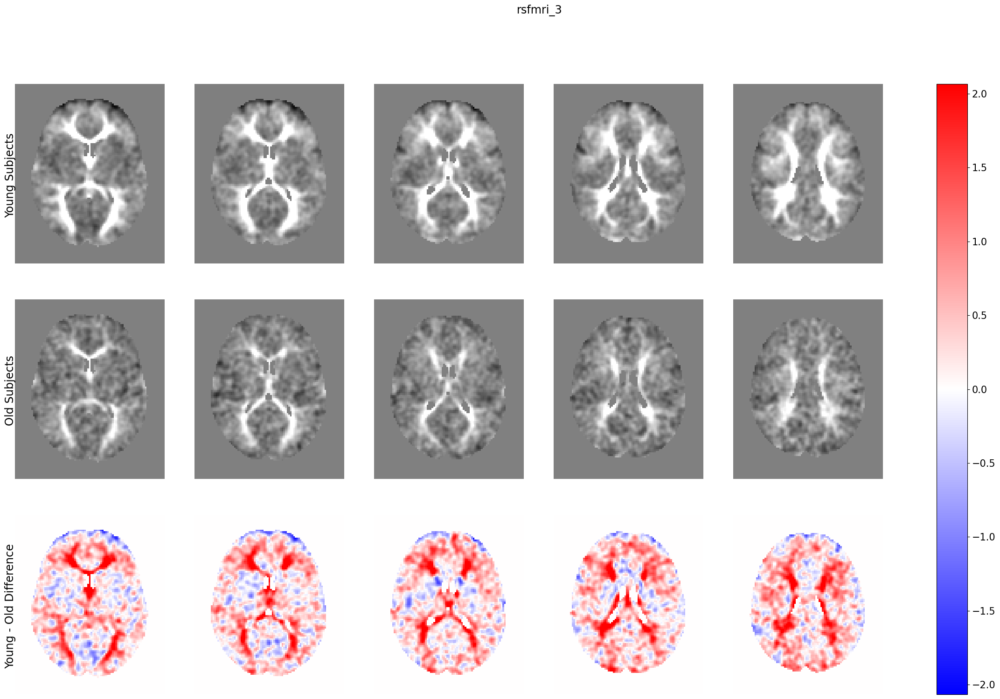

--------------------------------------------------------


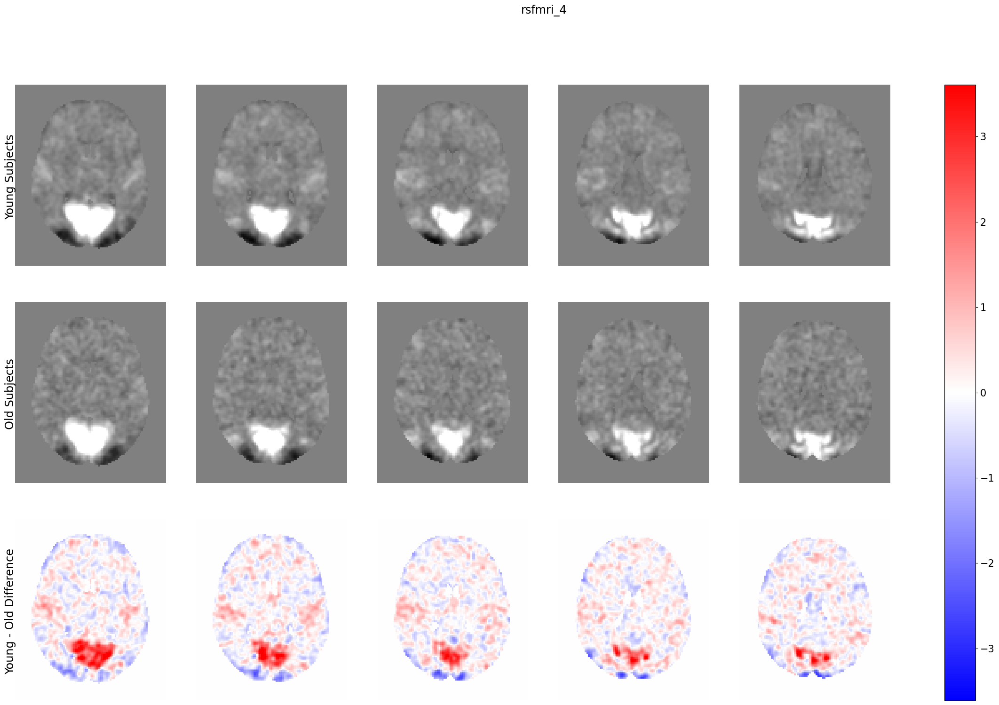

--------------------------------------------------------


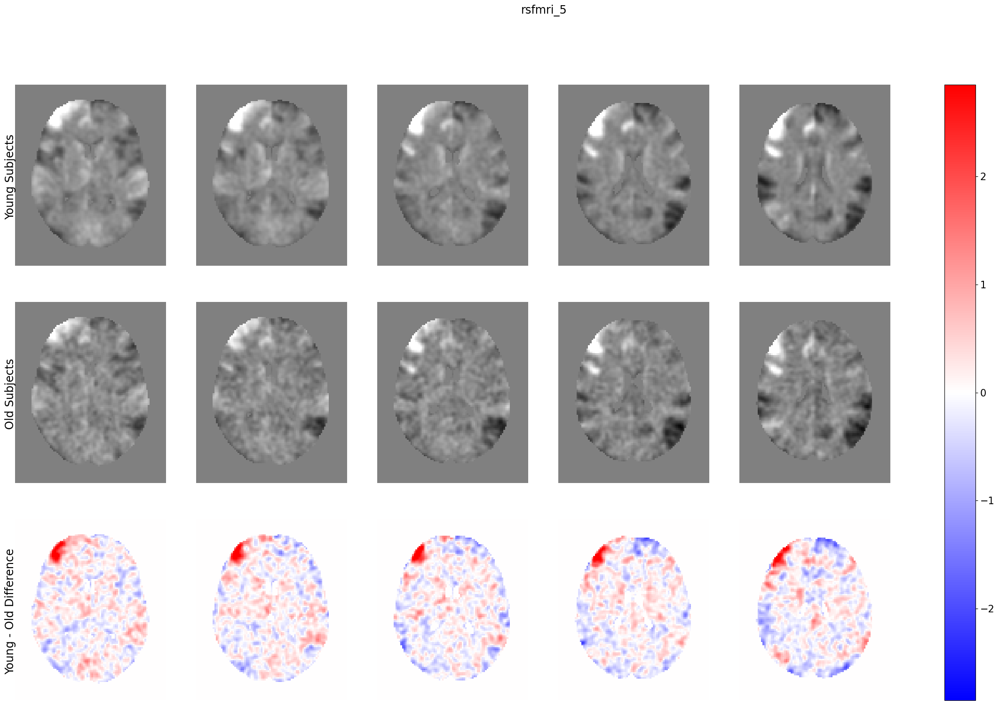

--------------------------------------------------------


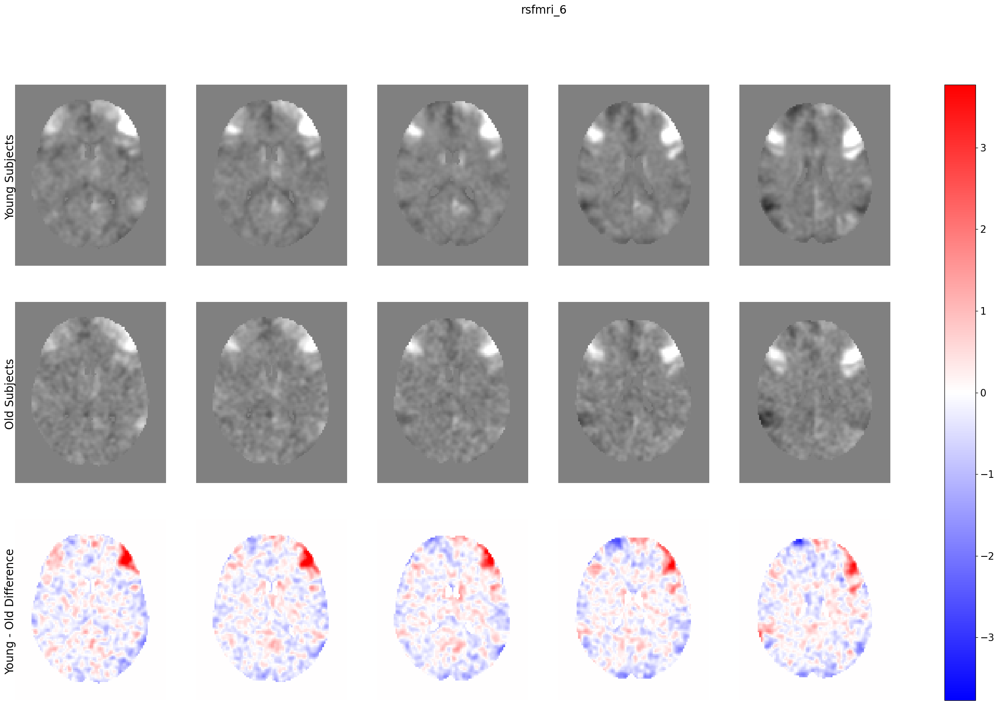

--------------------------------------------------------


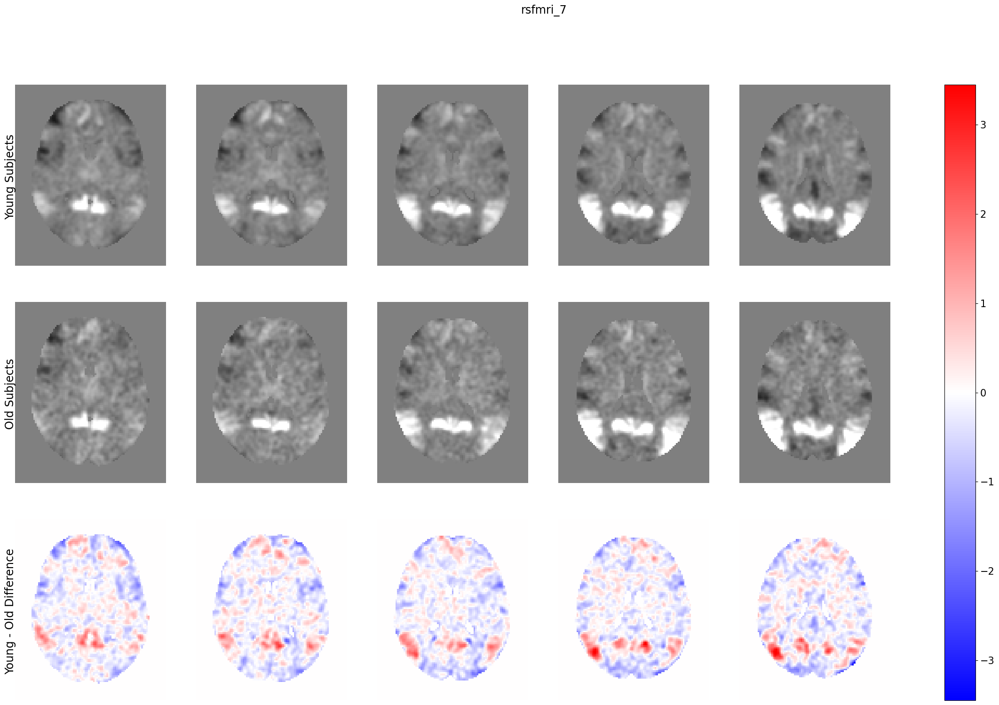

--------------------------------------------------------


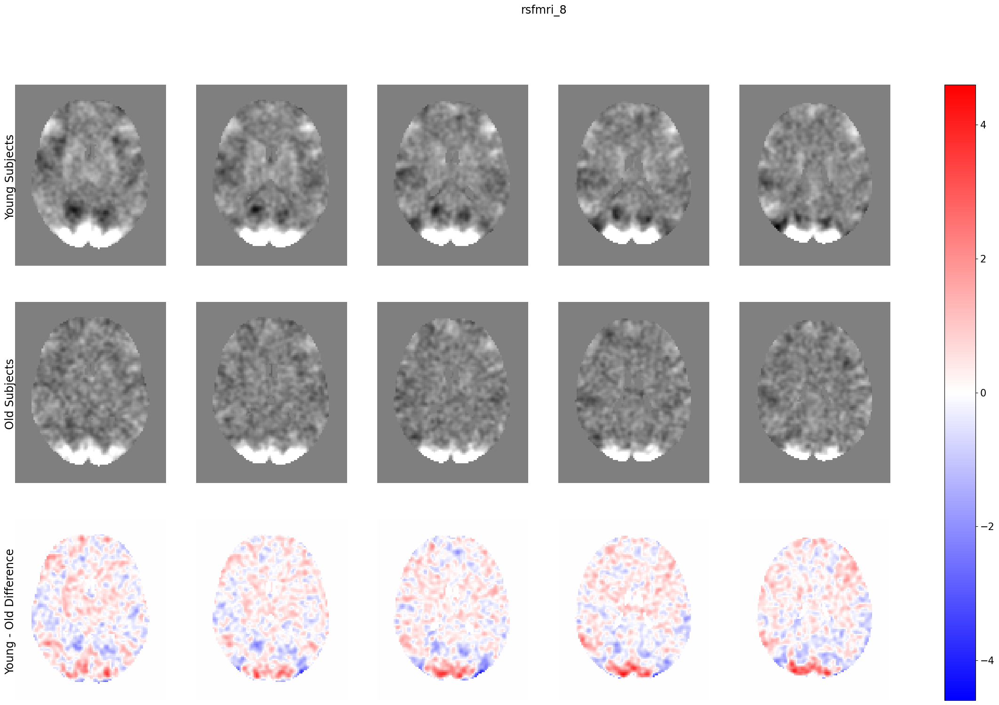

--------------------------------------------------------


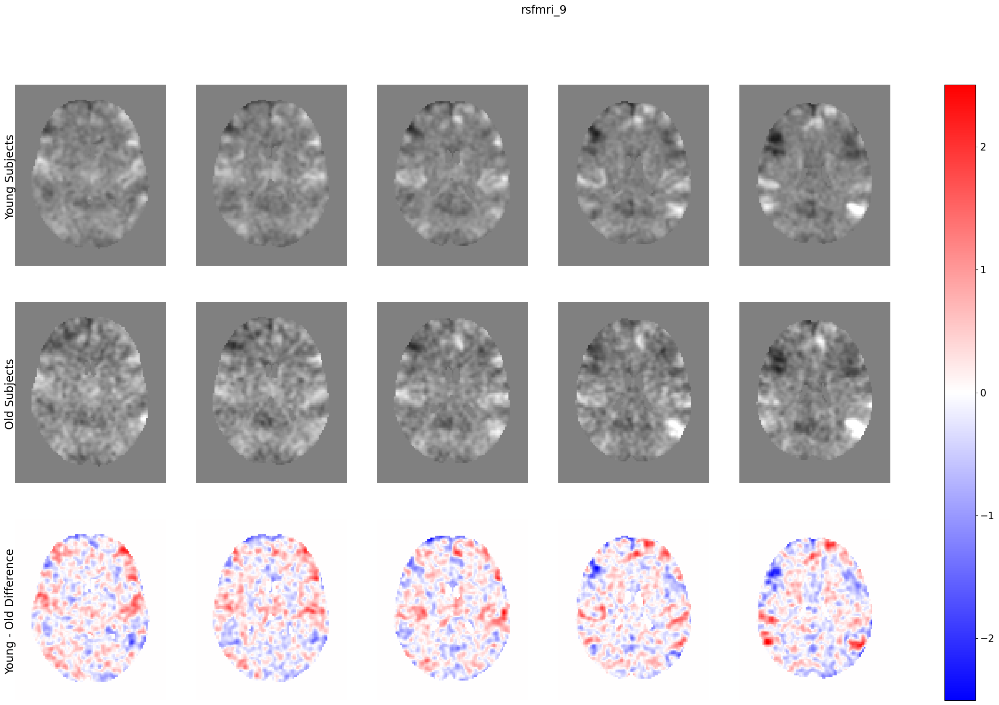

--------------------------------------------------------


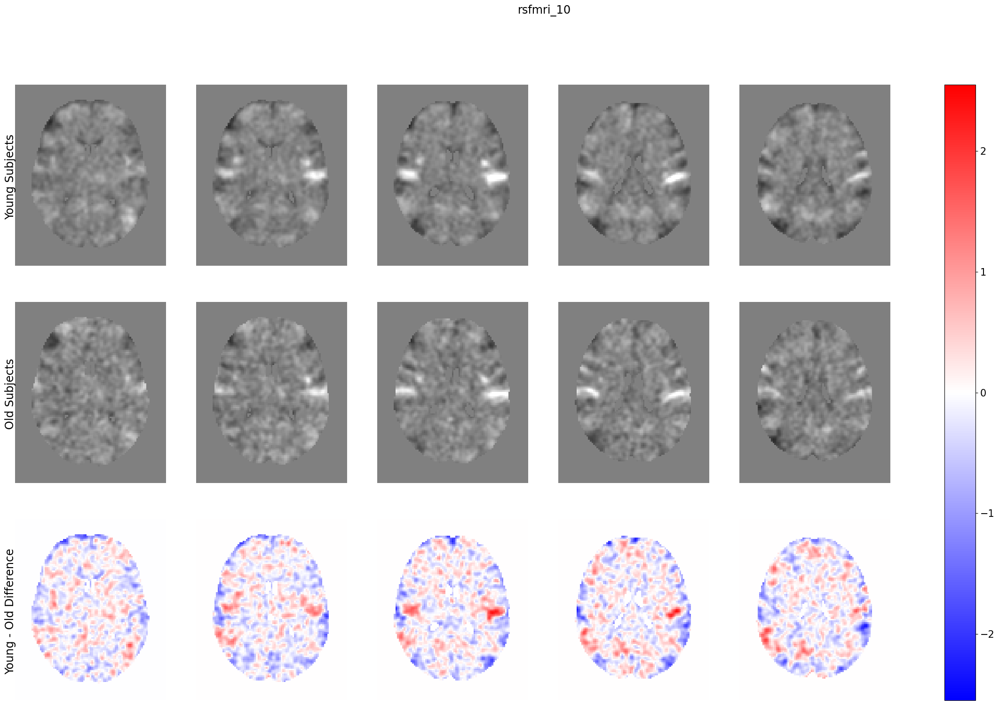

--------------------------------------------------------


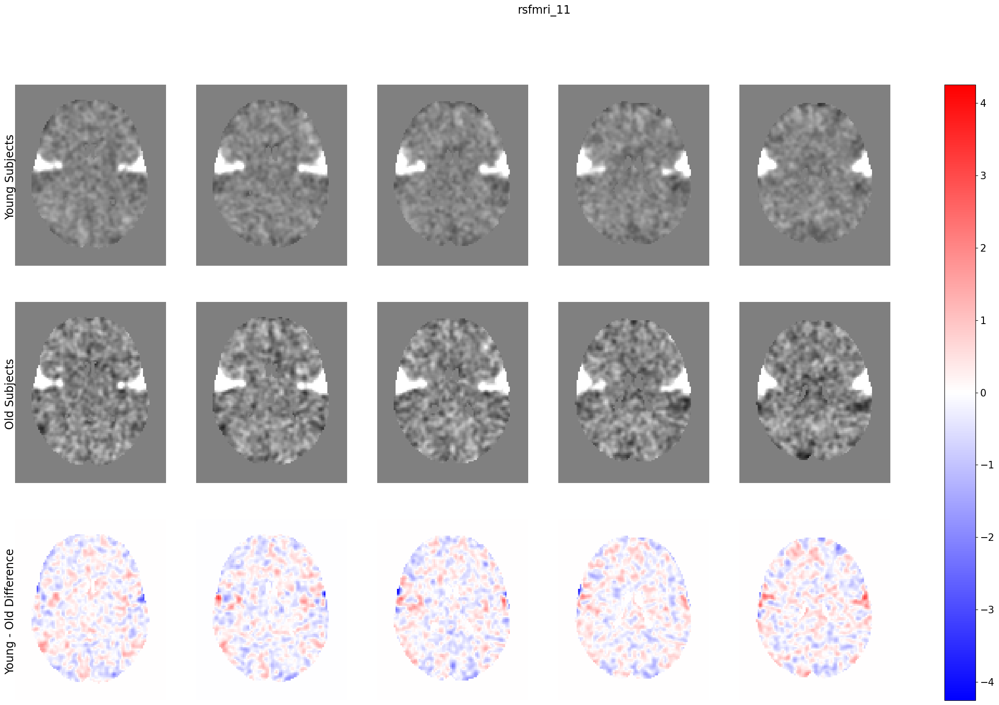

--------------------------------------------------------


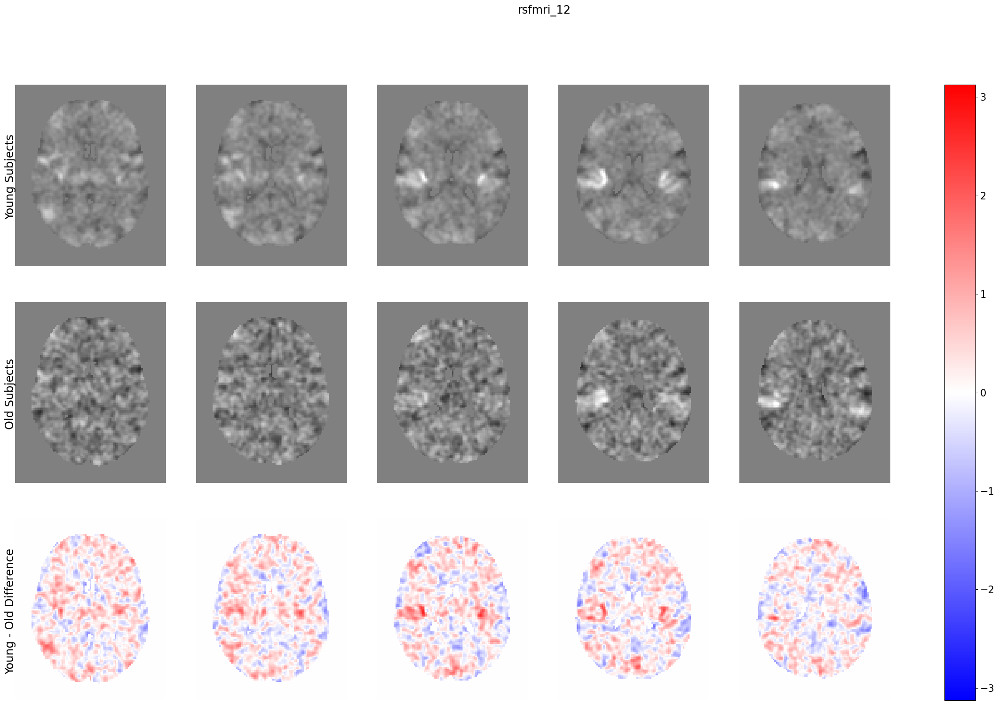

--------------------------------------------------------


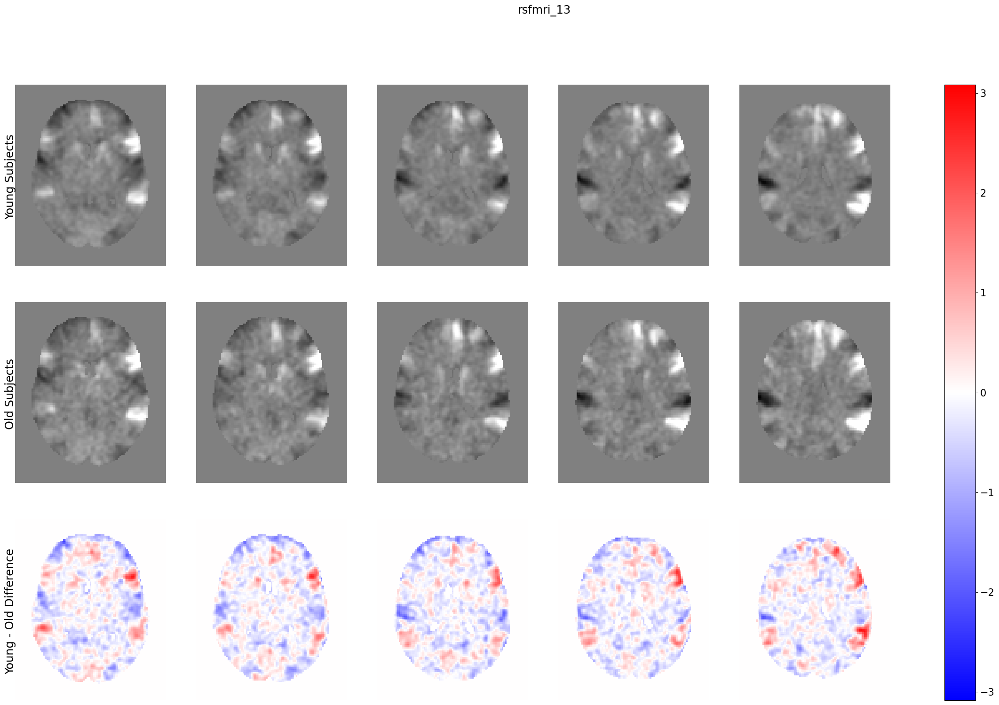

--------------------------------------------------------


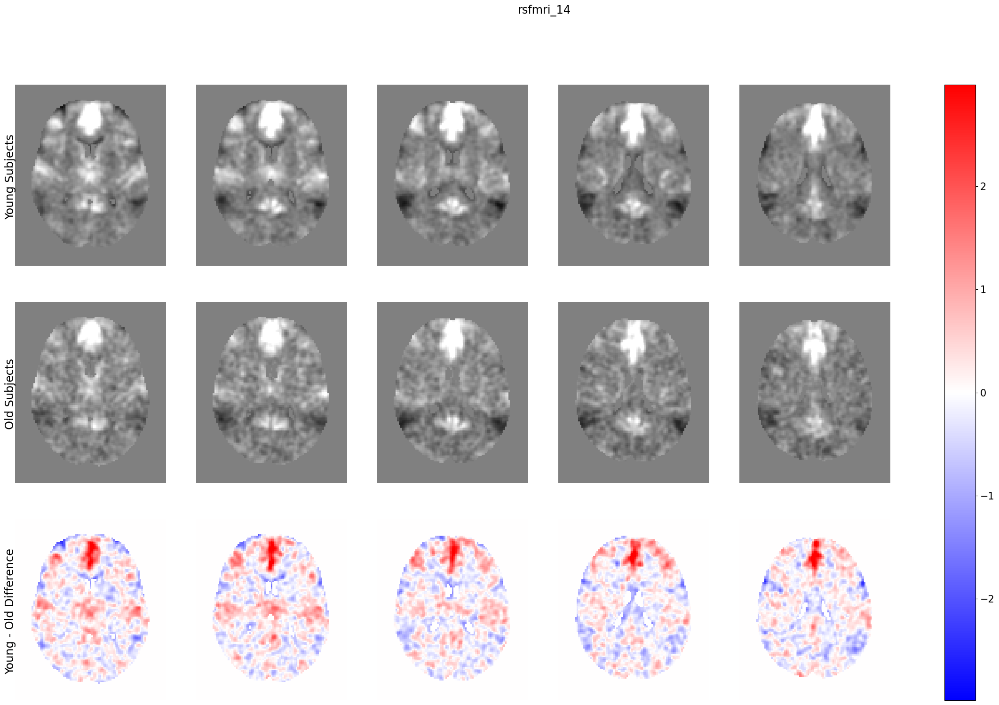

--------------------------------------------------------


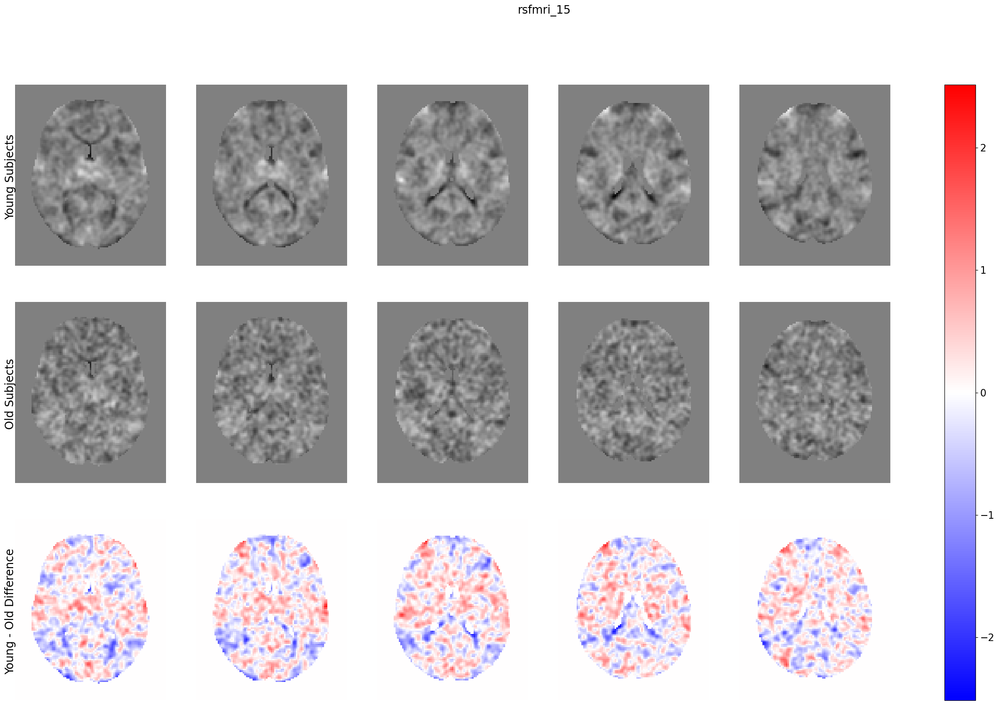

--------------------------------------------------------


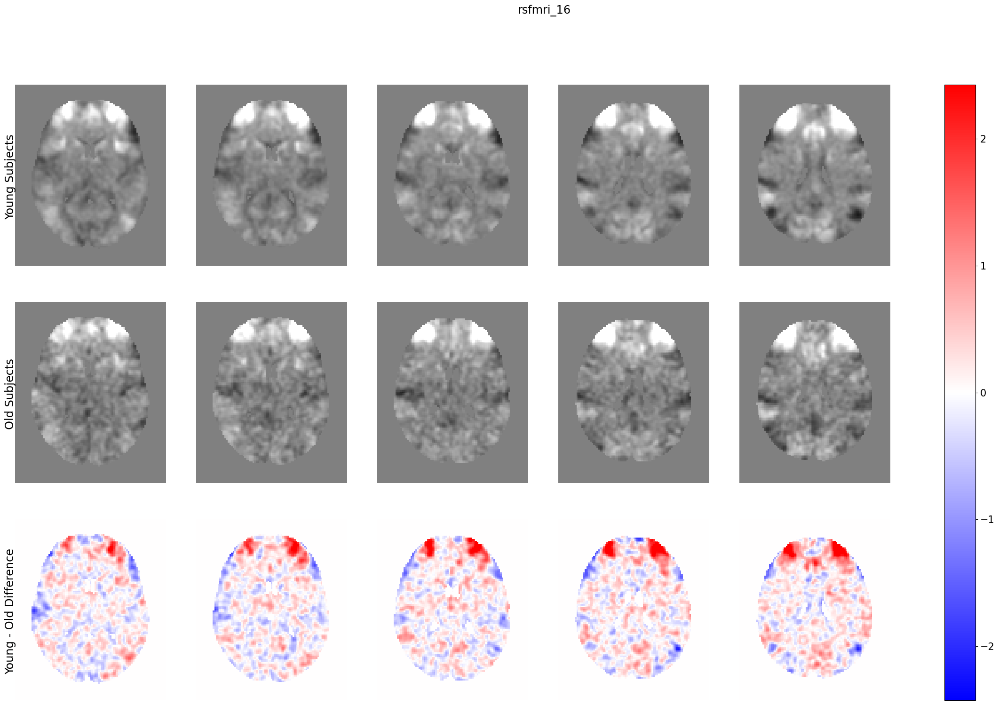

--------------------------------------------------------


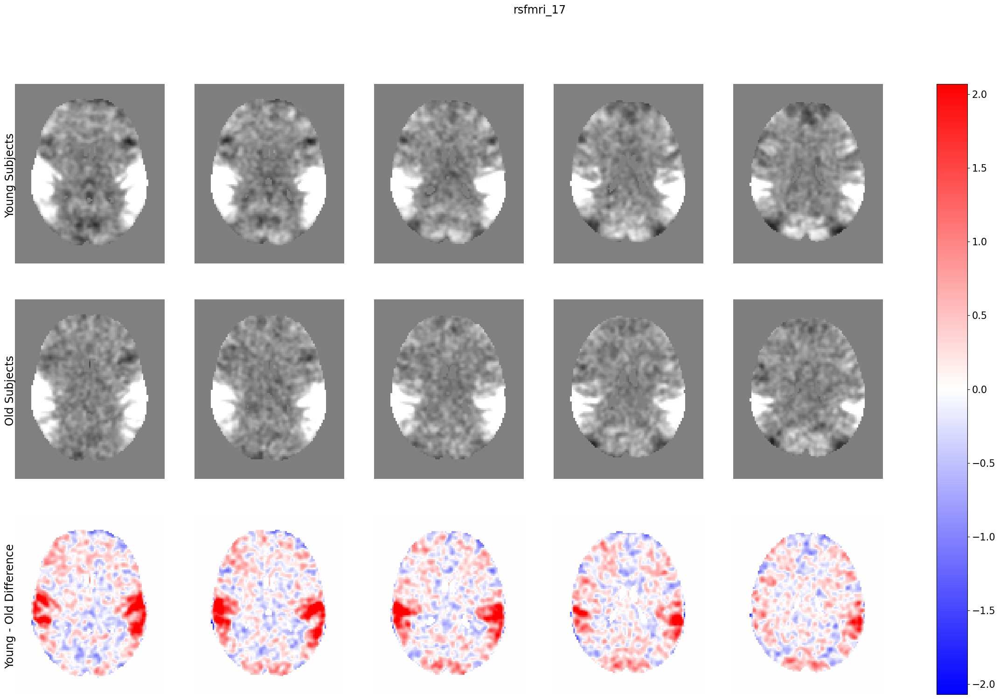

--------------------------------------------------------


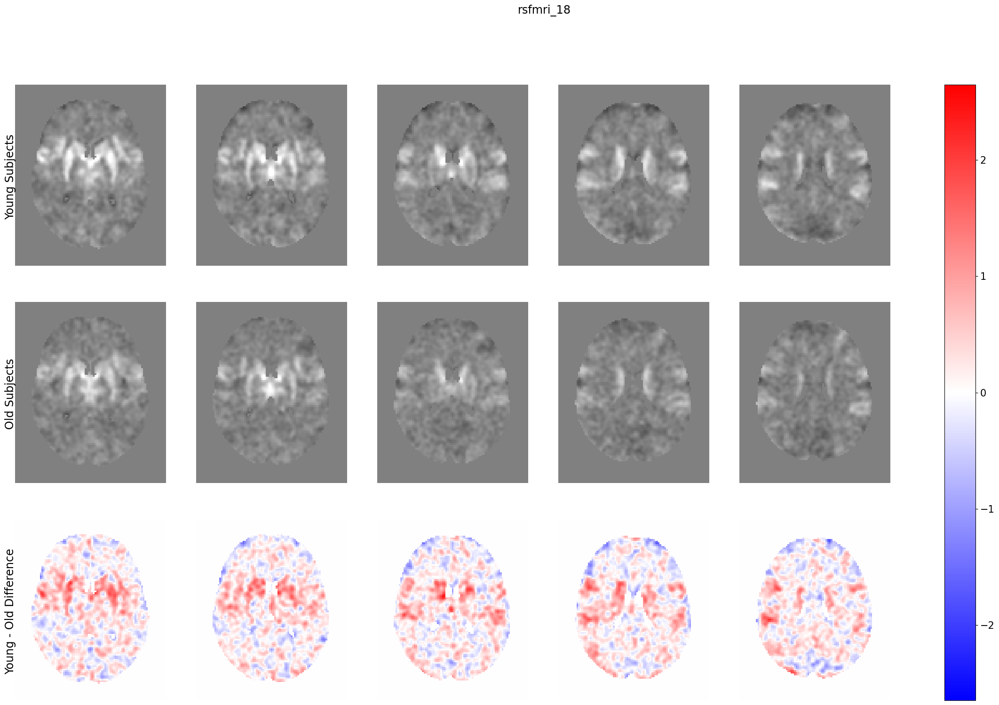

--------------------------------------------------------


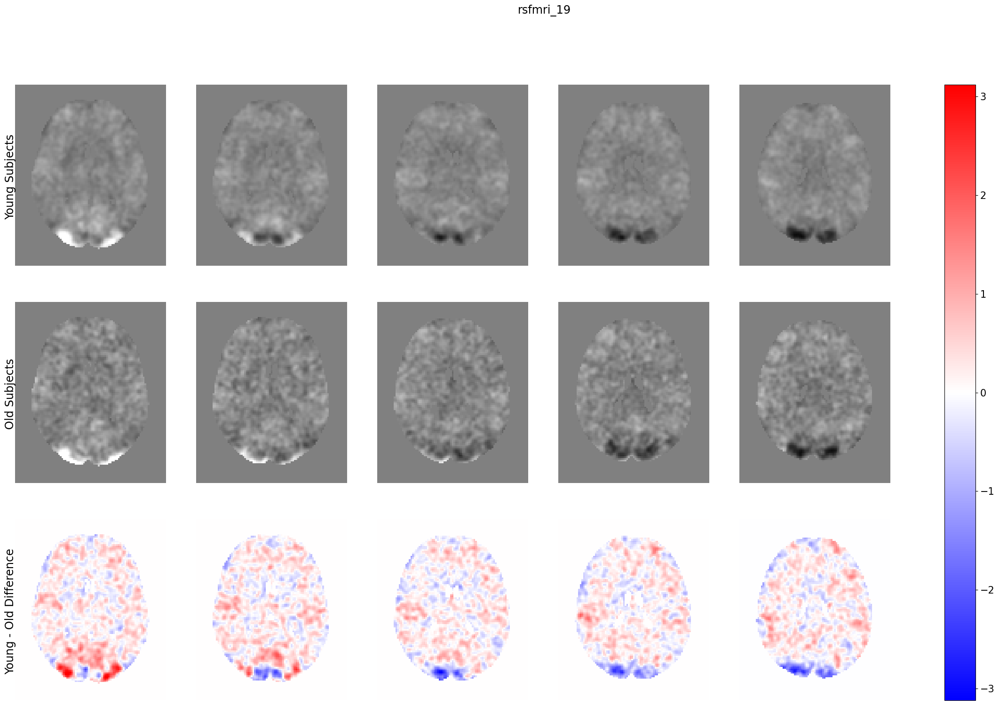

--------------------------------------------------------


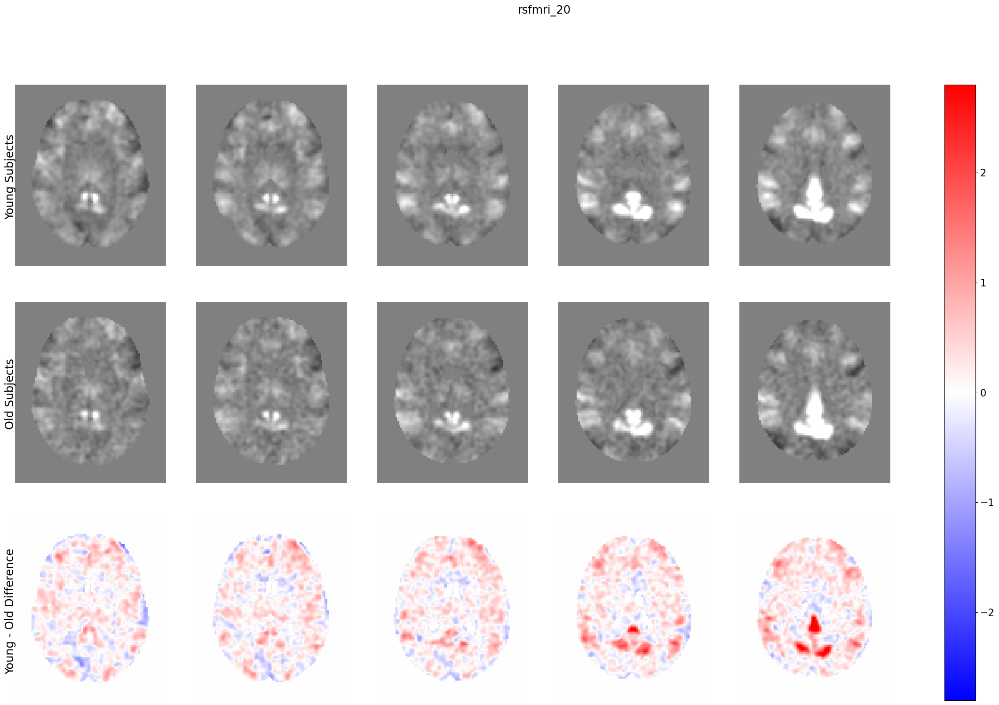

--------------------------------------------------------


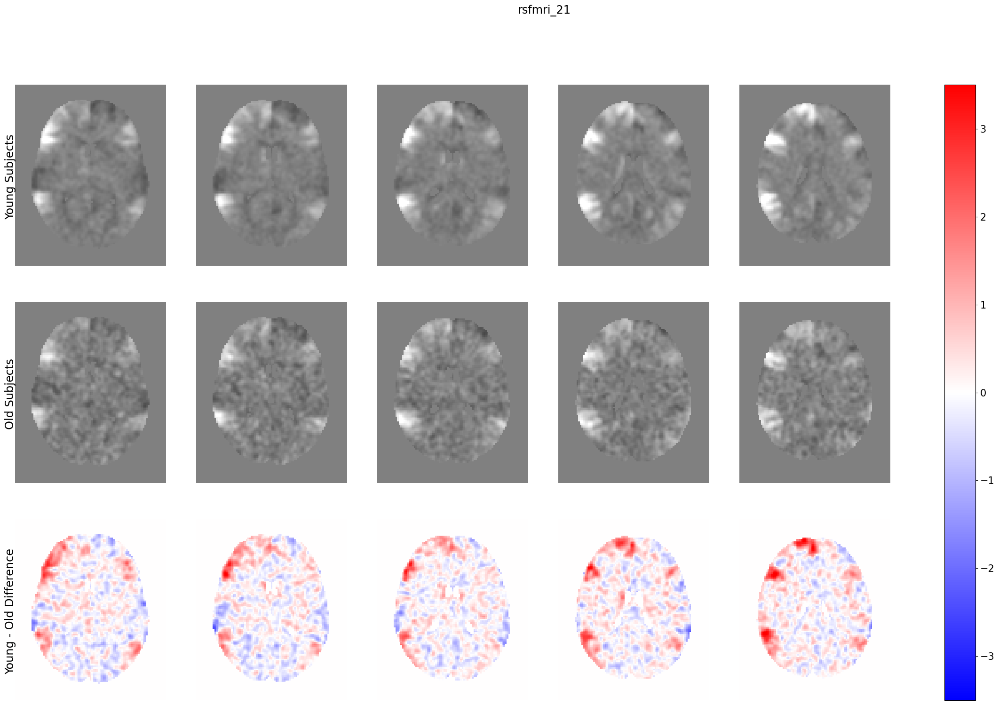

--------------------------------------------------------


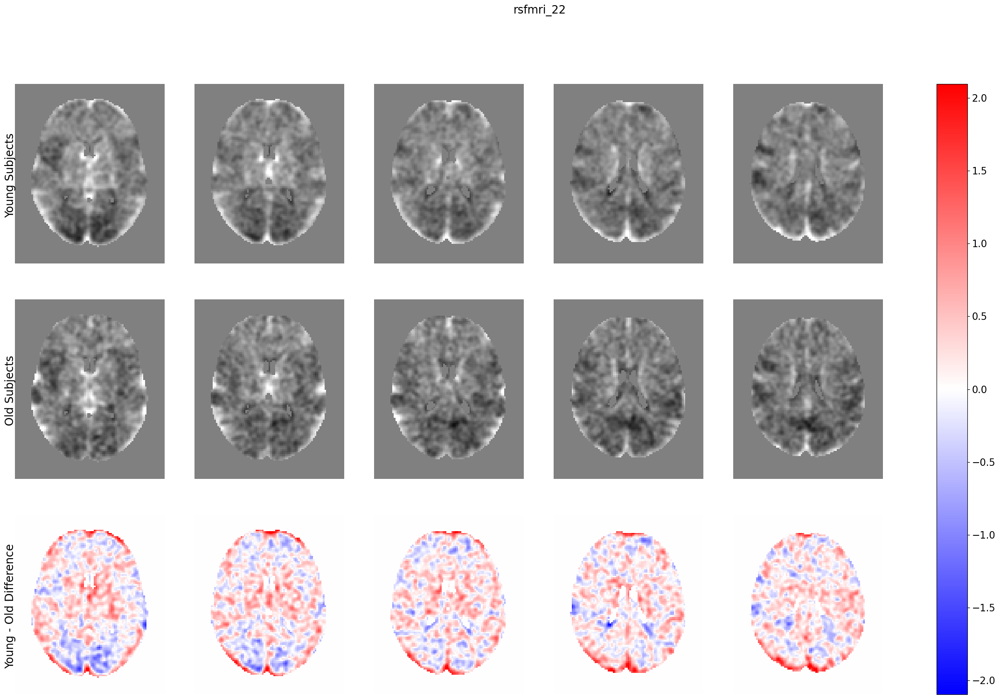

--------------------------------------------------------


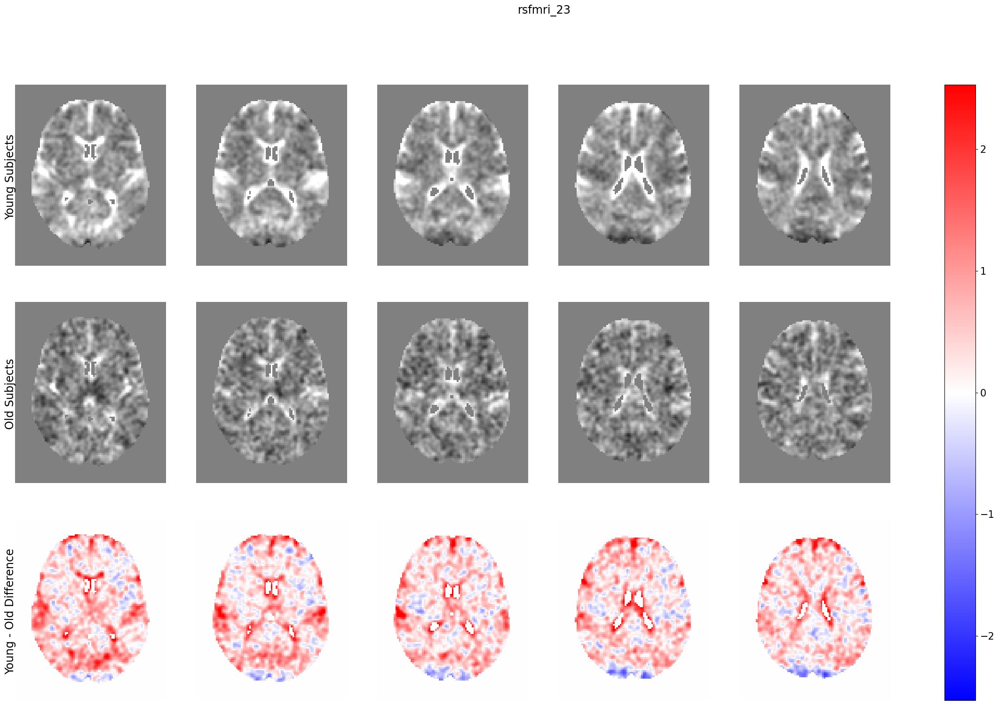

--------------------------------------------------------


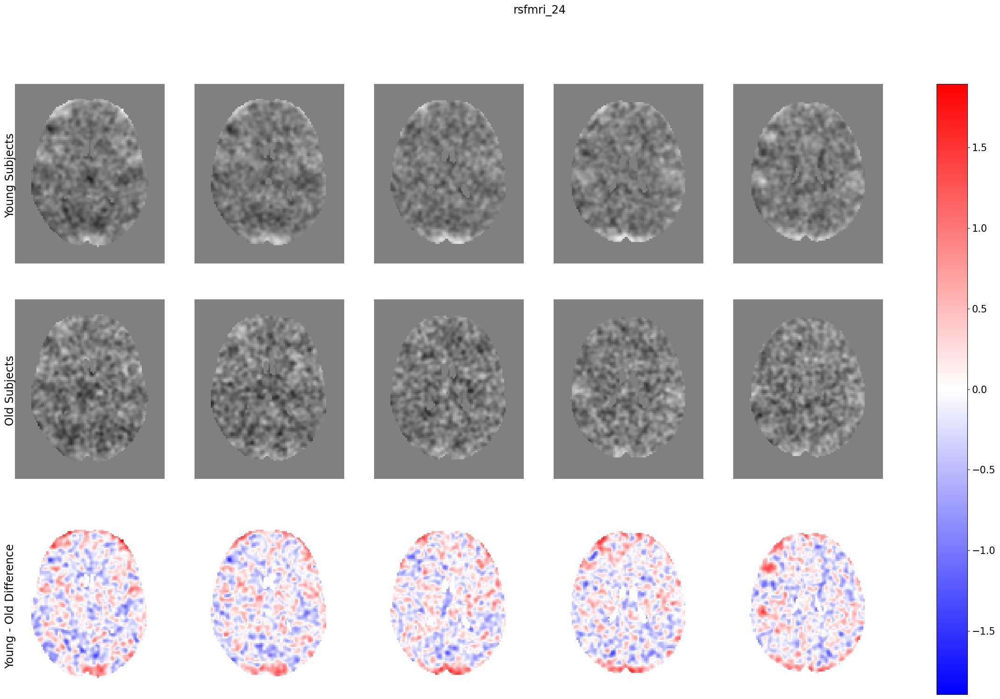

--------------------------------------------------------


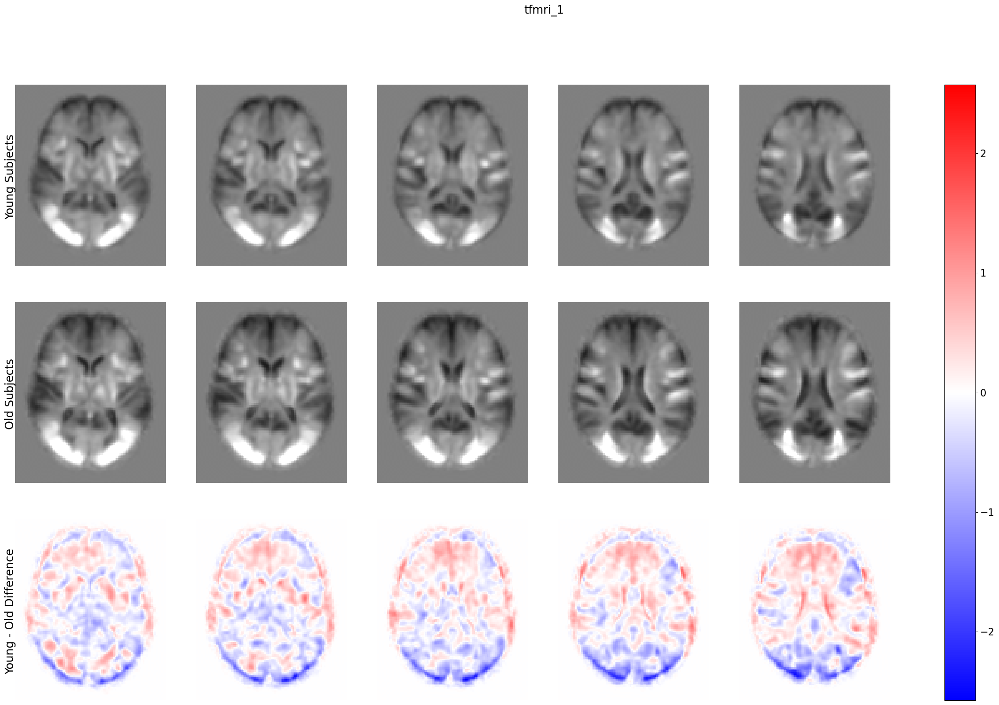

--------------------------------------------------------


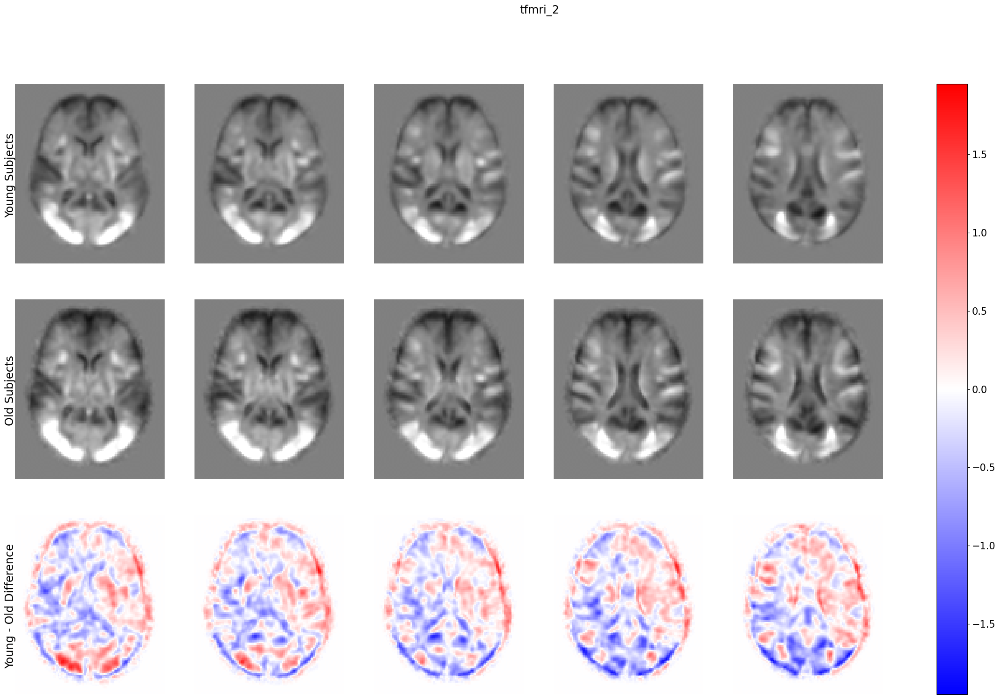

--------------------------------------------------------


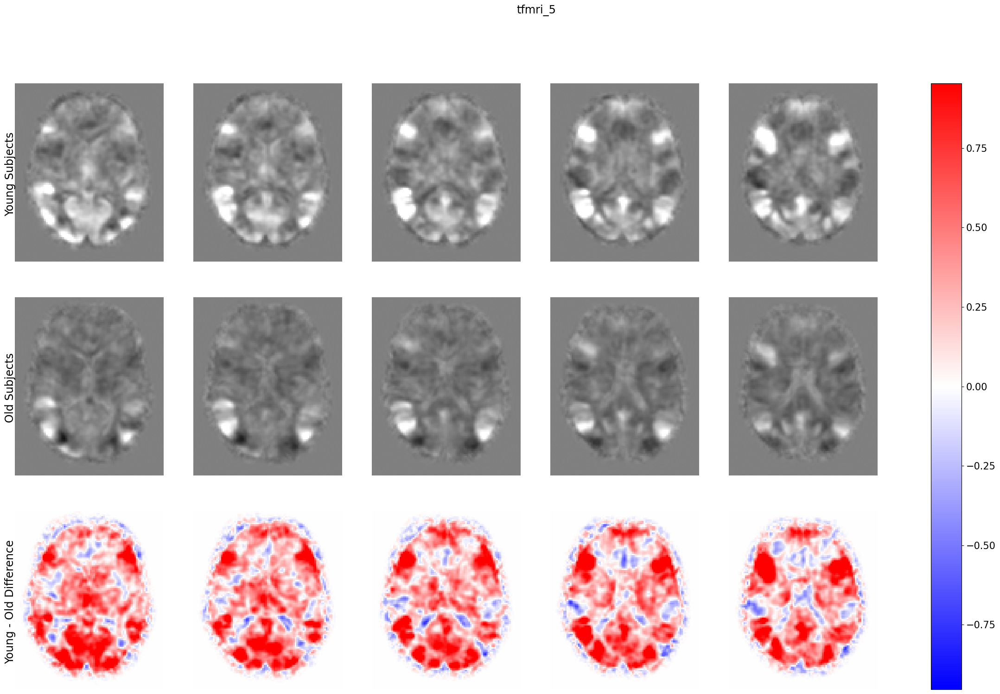

--------------------------------------------------------


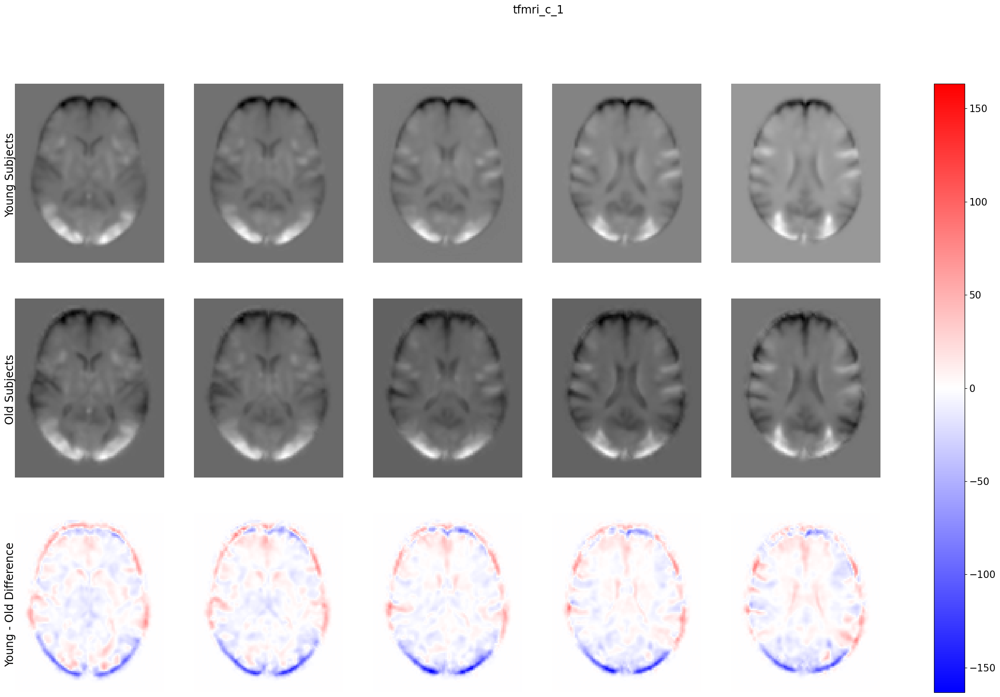

--------------------------------------------------------


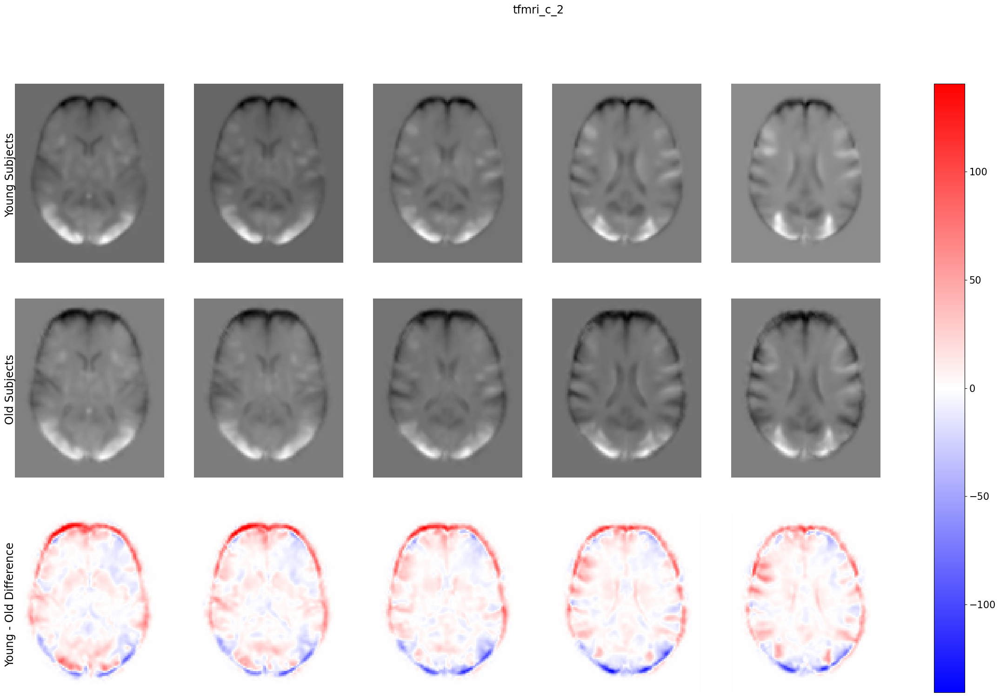

--------------------------------------------------------


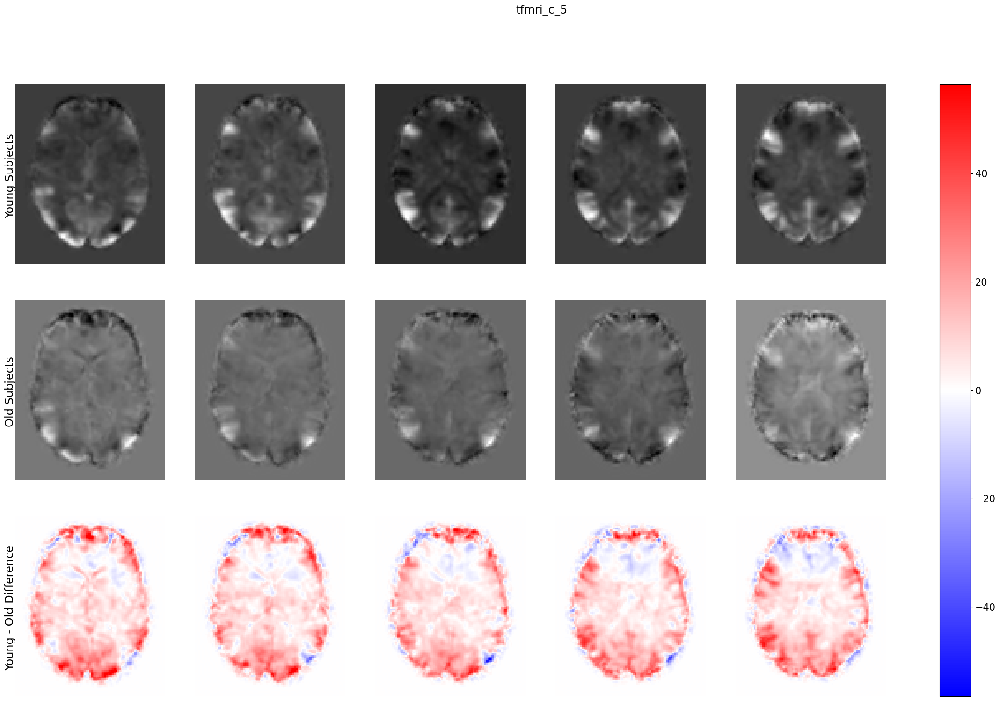

--------------------------------------------------------


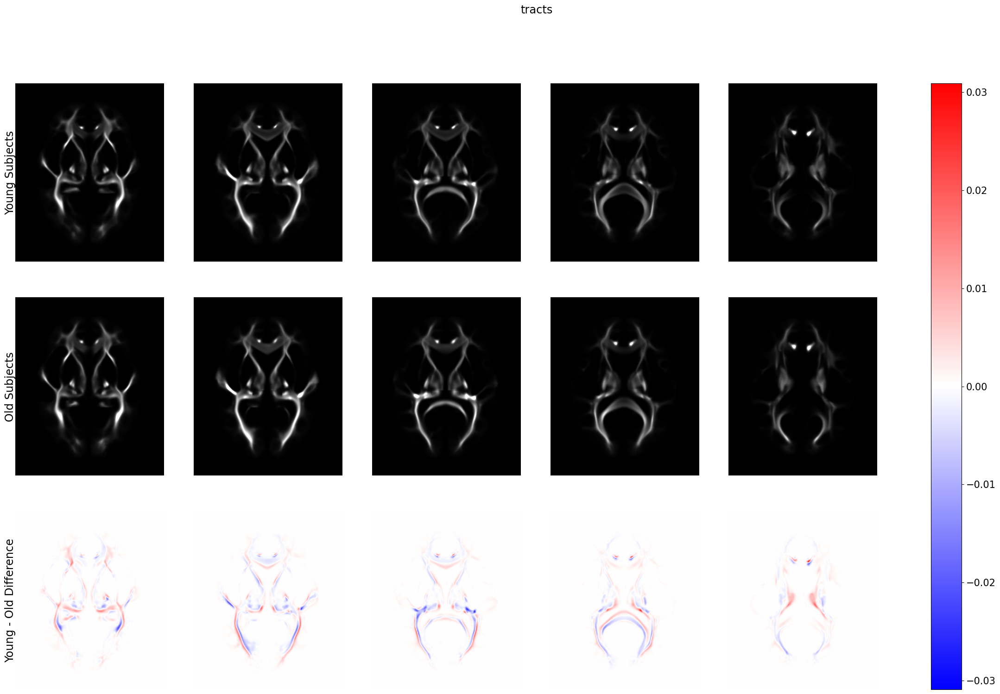

--------------------------------------------------------


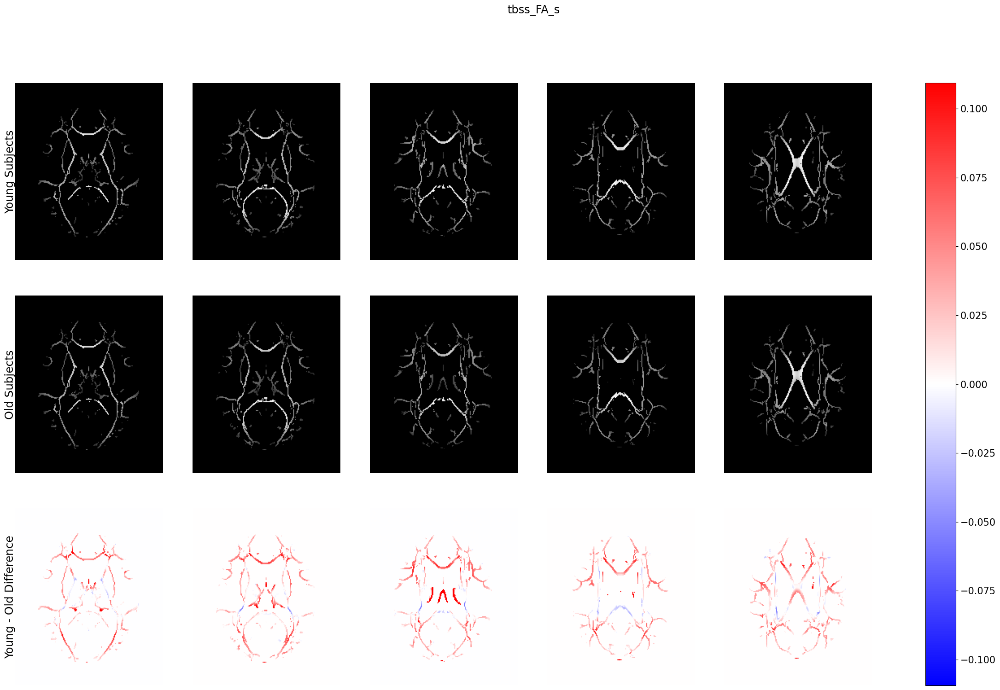

--------------------------------------------------------


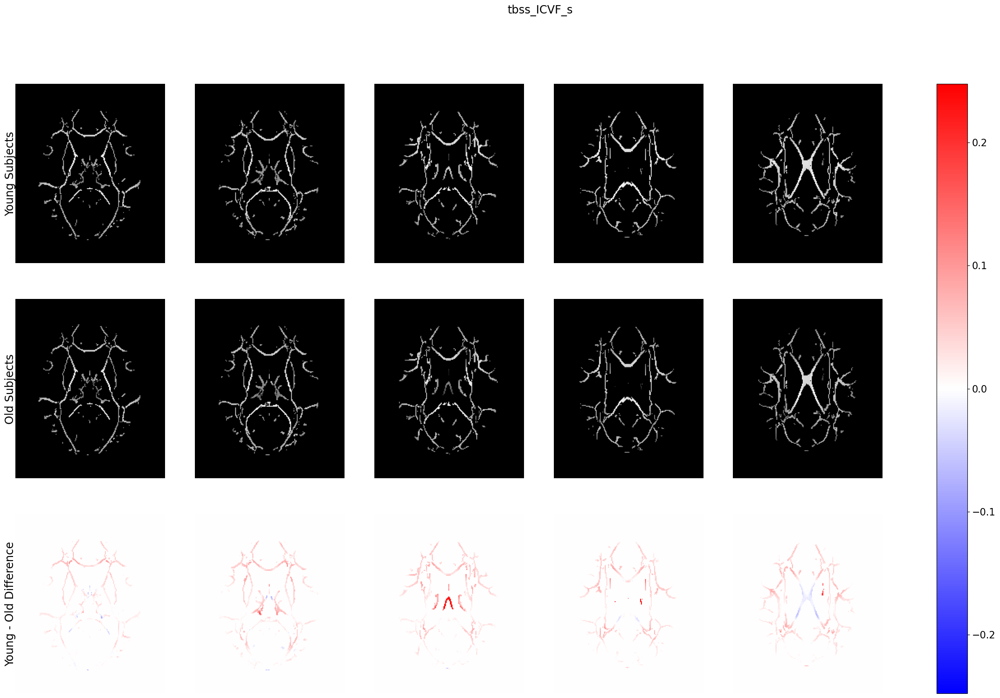

--------------------------------------------------------


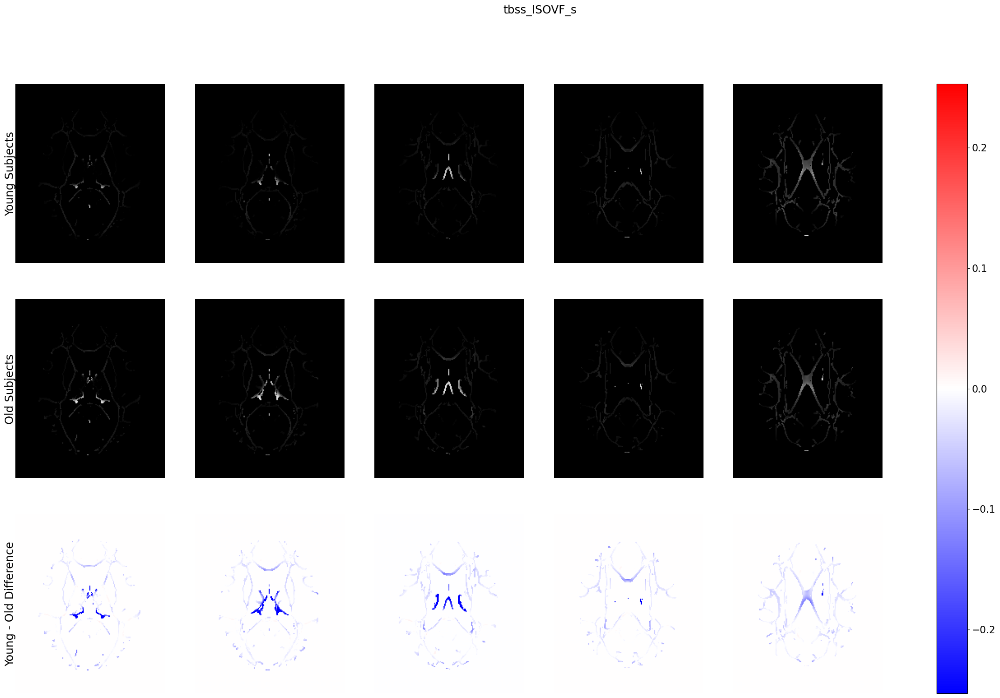

--------------------------------------------------------


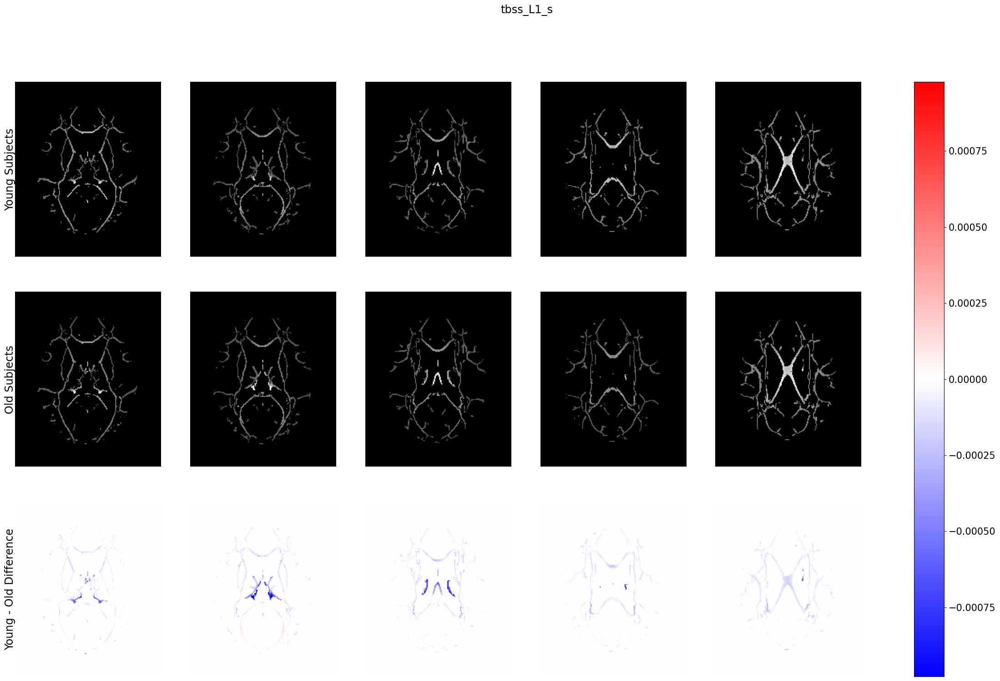

--------------------------------------------------------


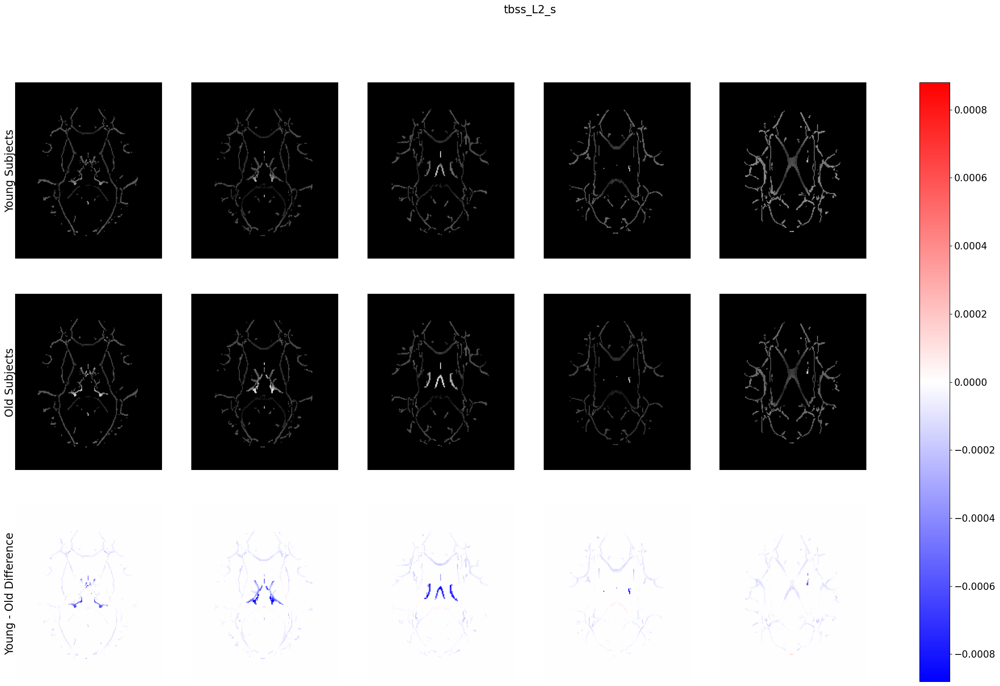

--------------------------------------------------------


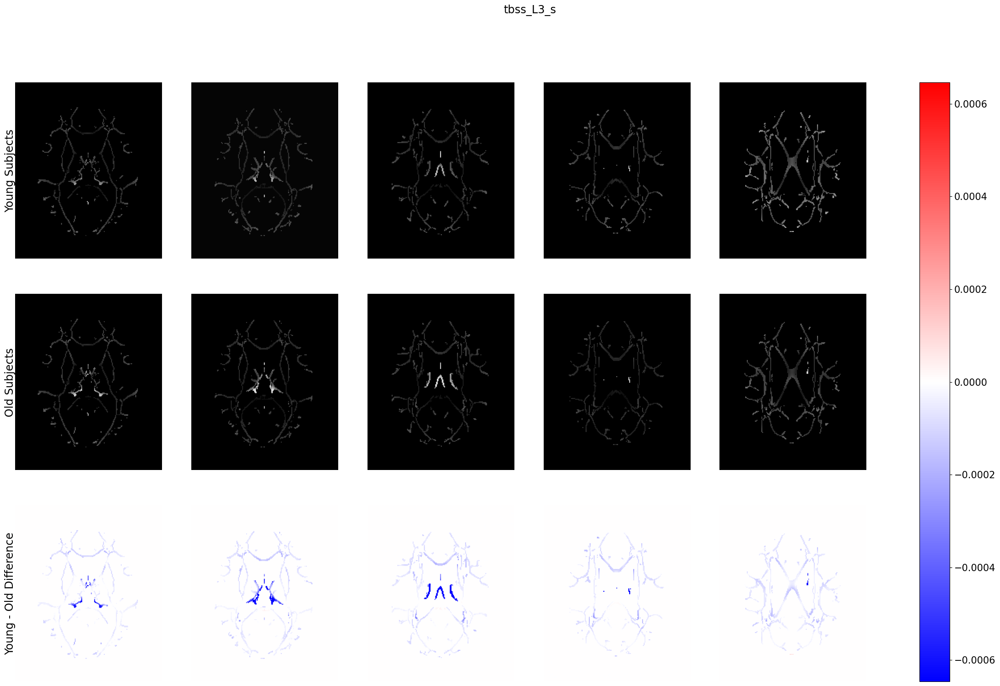

--------------------------------------------------------


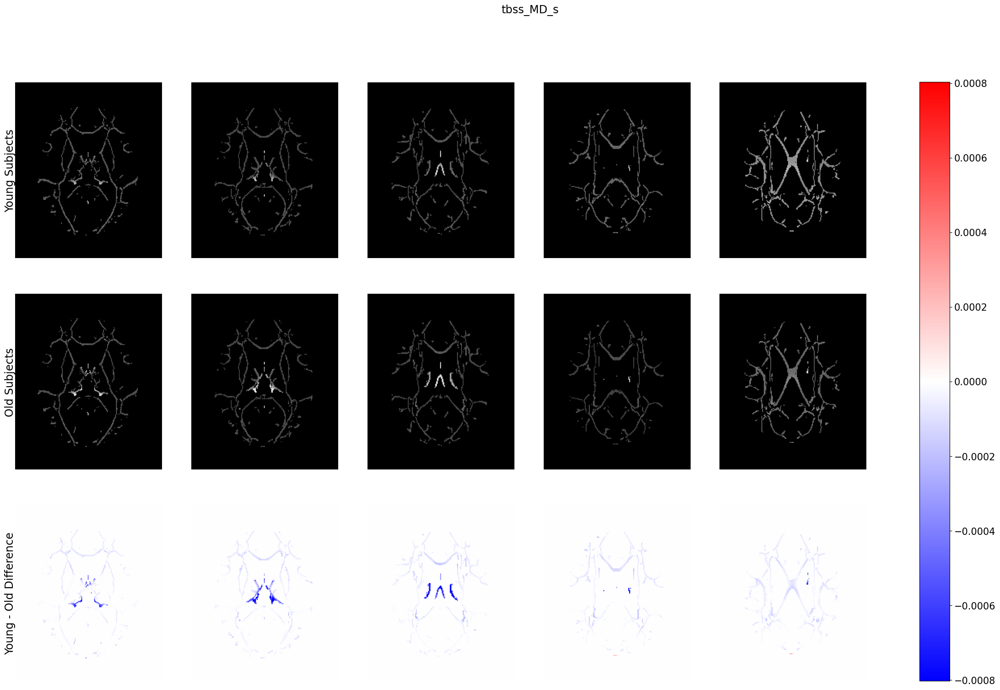

--------------------------------------------------------


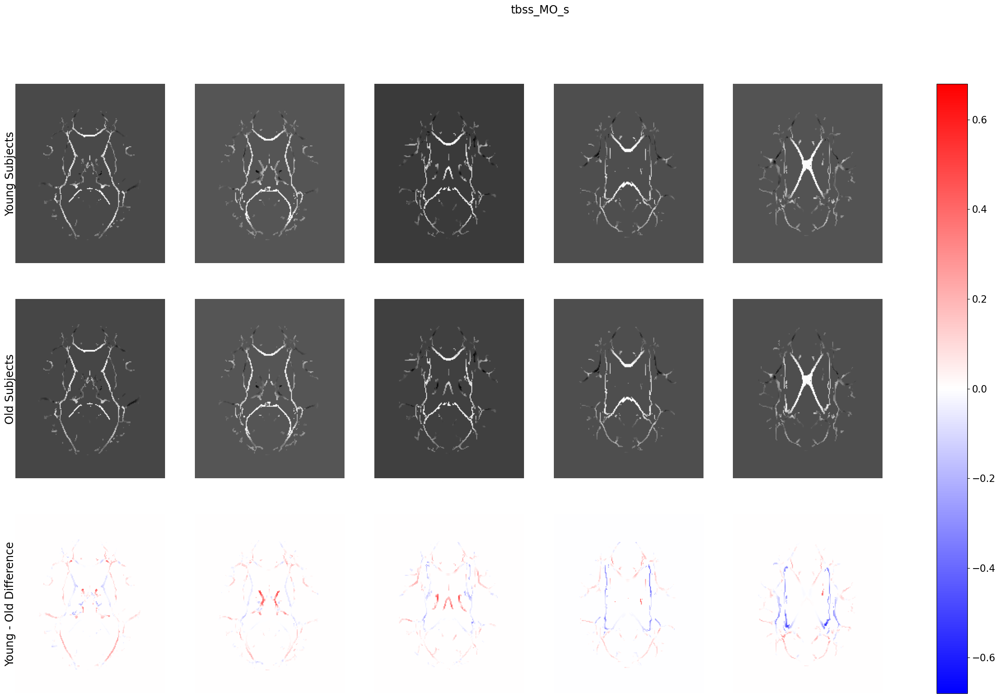

--------------------------------------------------------


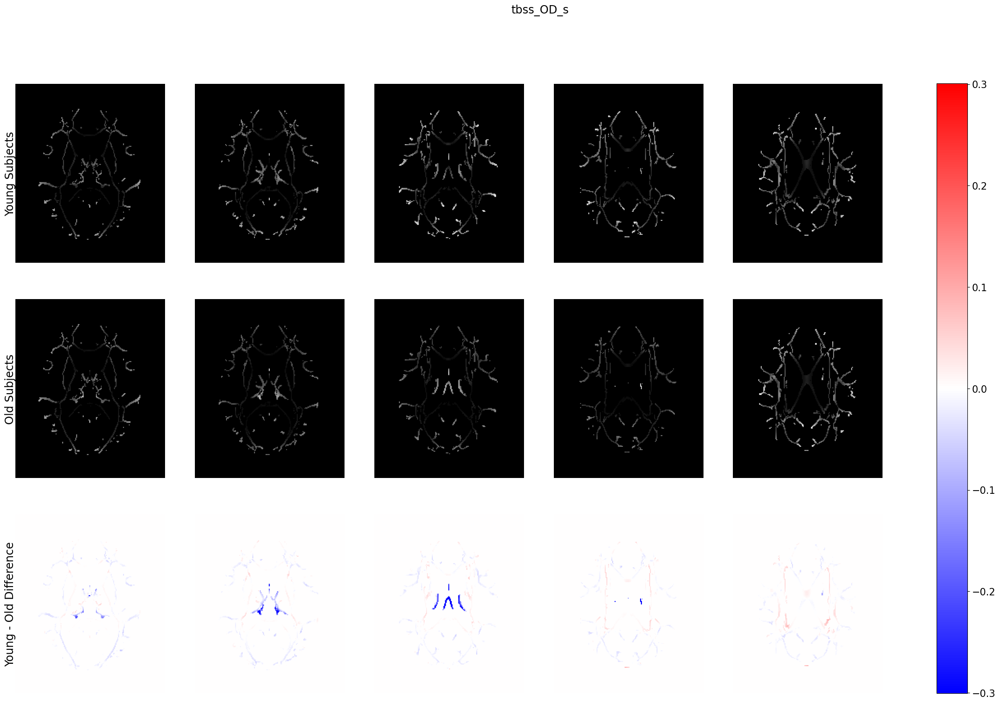

--------------------------------------------------------


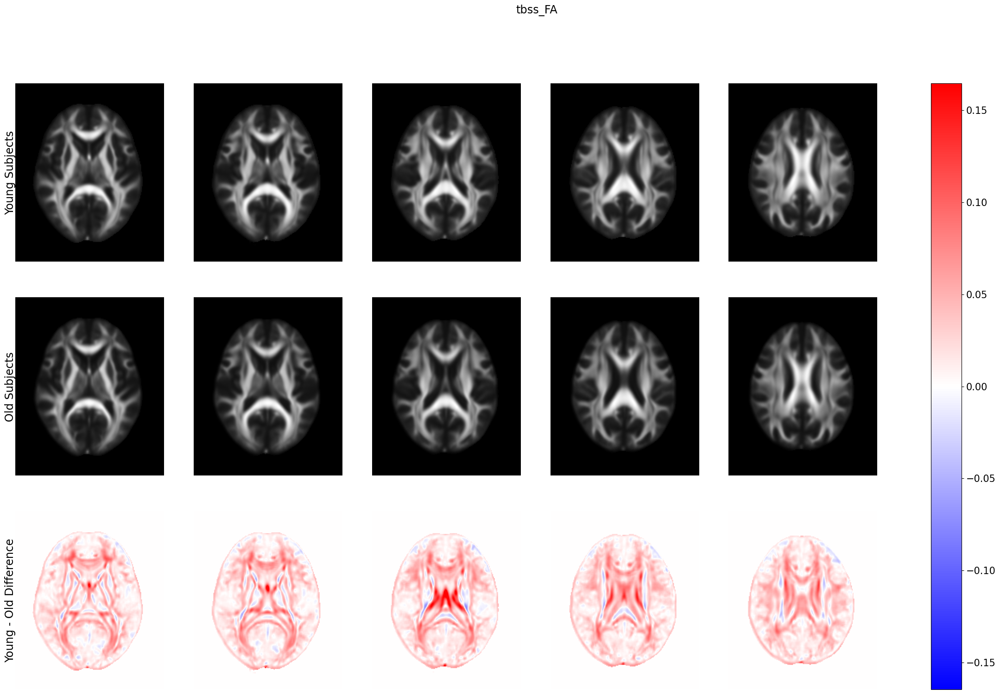

--------------------------------------------------------


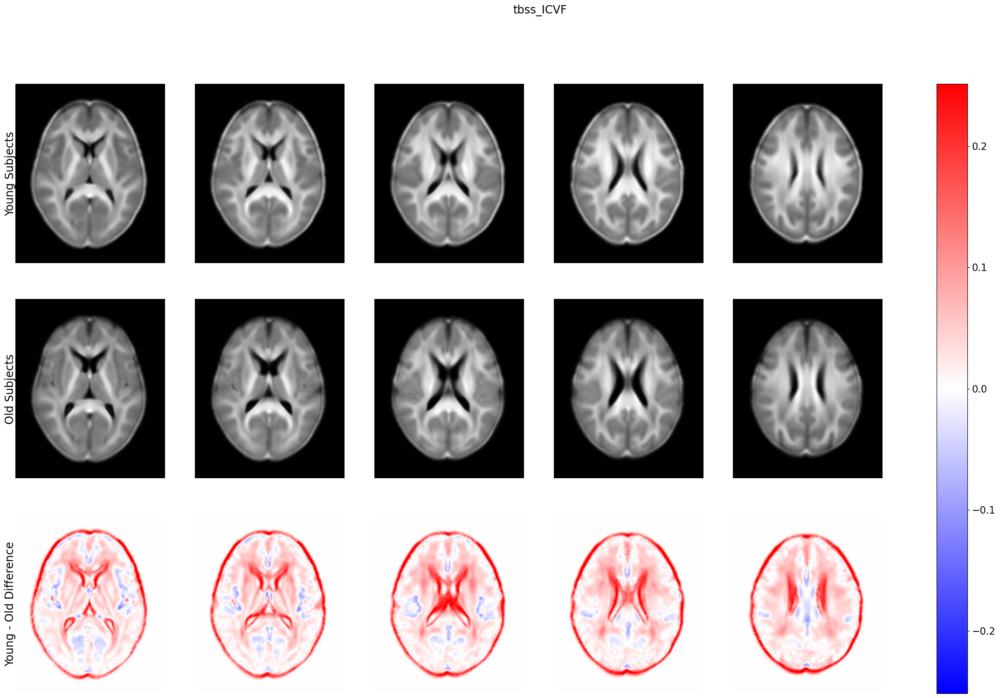

--------------------------------------------------------


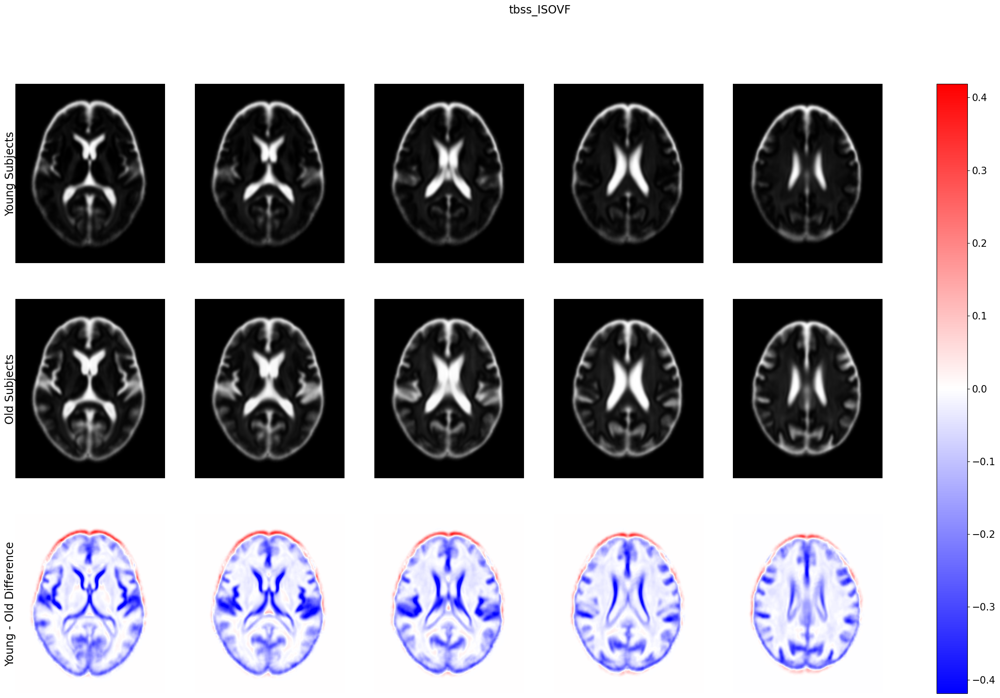

--------------------------------------------------------


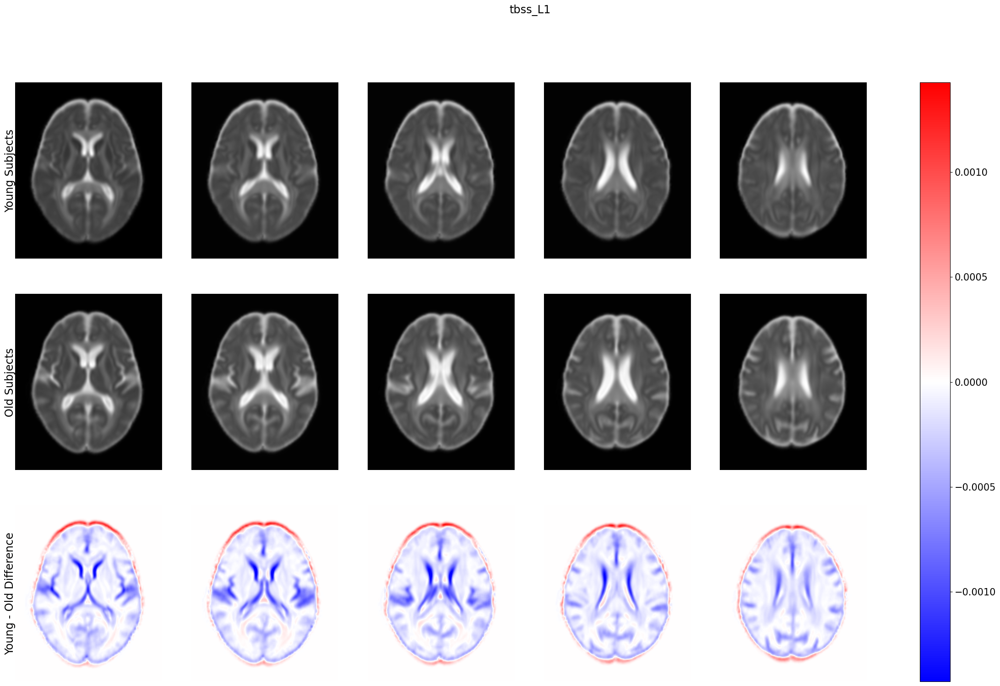

--------------------------------------------------------


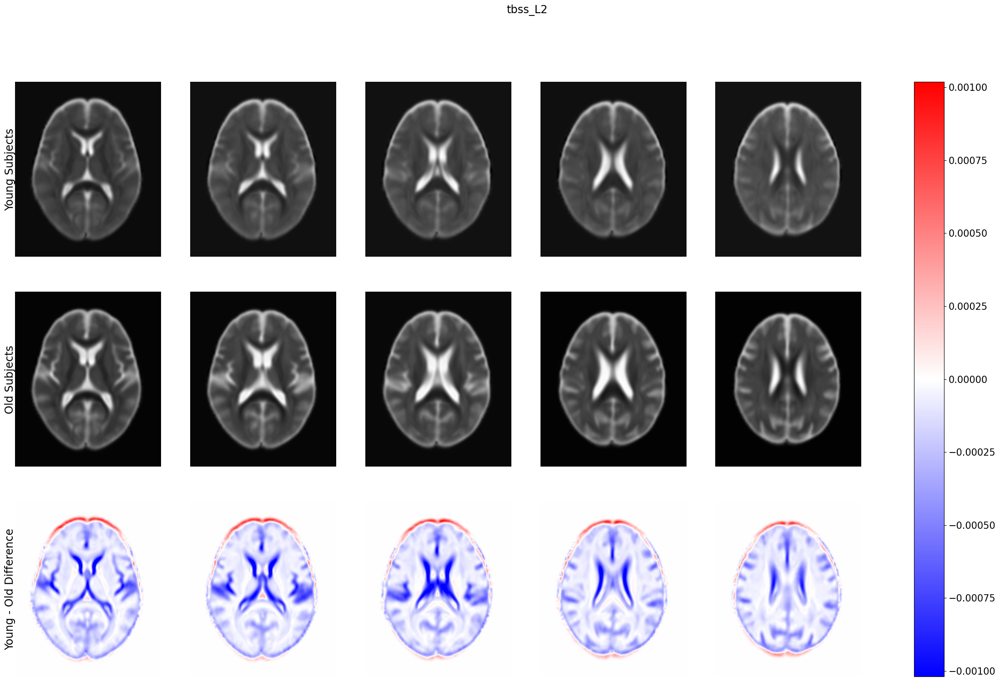

--------------------------------------------------------


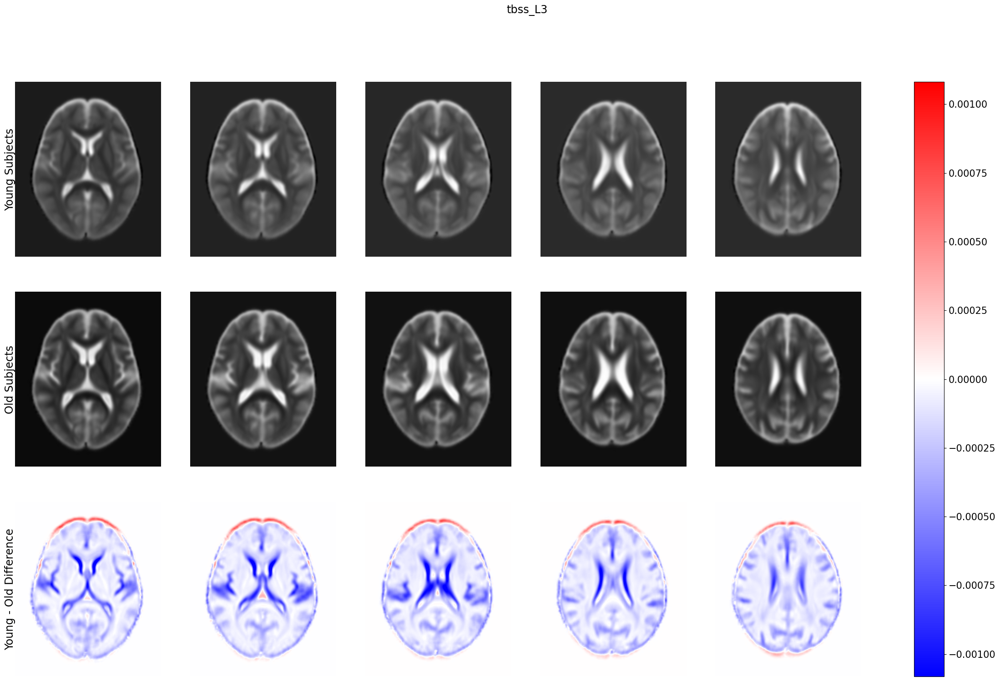

--------------------------------------------------------


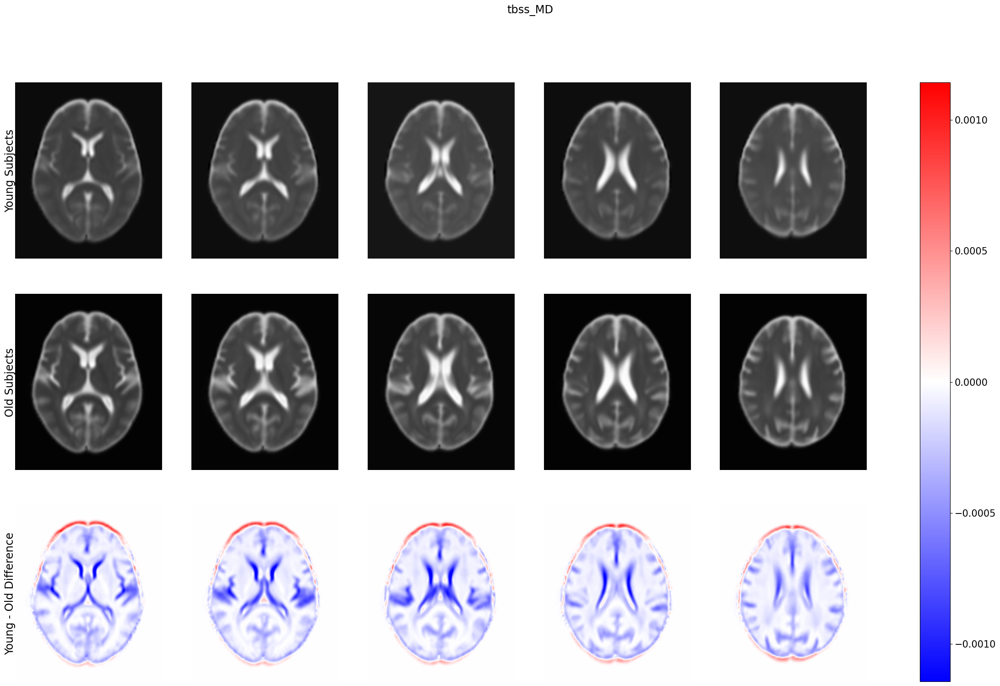

--------------------------------------------------------


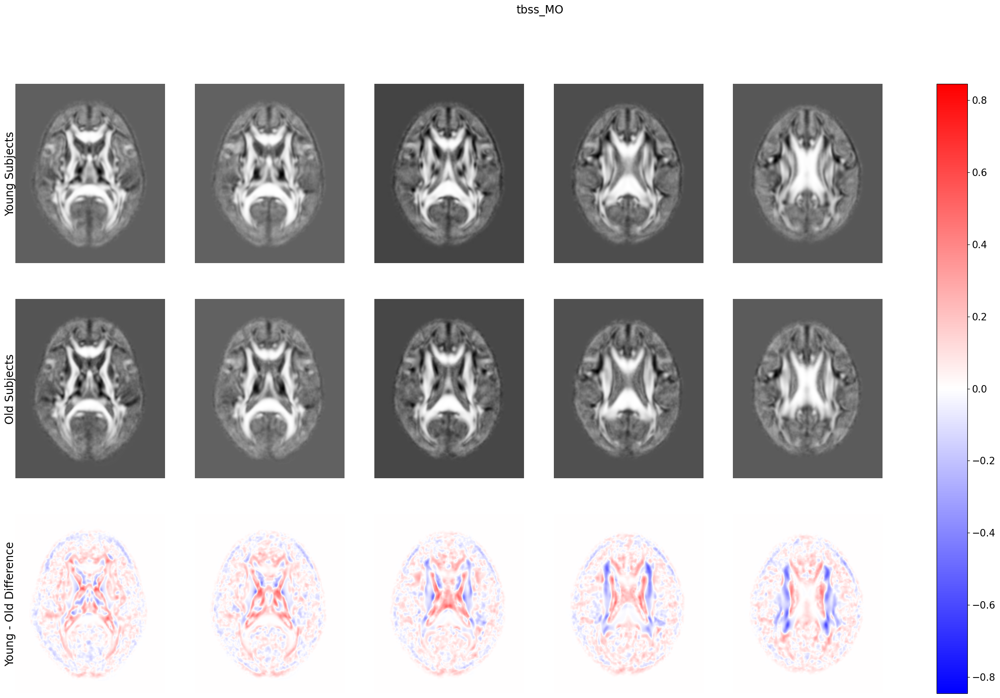

--------------------------------------------------------


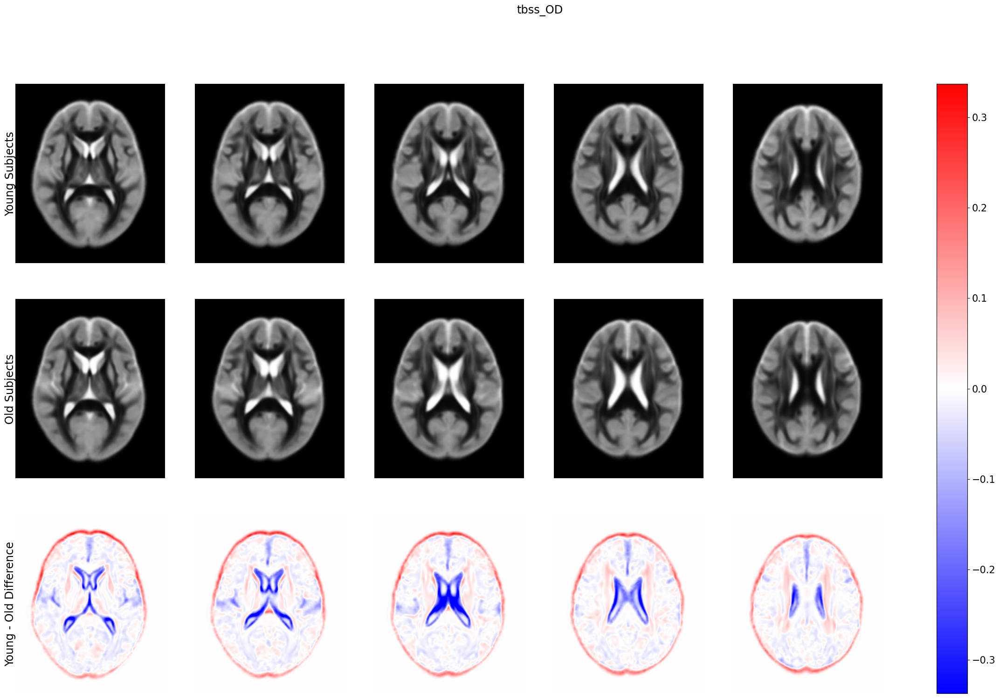

--------------------------------------------------------


In [17]:
for modality in modalities:
    visualise_all_maps(modality)
    print('--------------------------------------------------------')